# Data study

In the course of the project we are going to analize and optimize marketing expenses of Yandex.Afisha.
WE are going to look into data related to site visits, orders and costs from June 2017 through May 2018. 

In [1]:
import pandas as pd
import plotly
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import sys
import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")
from scipy import stats as st
import numpy

import seaborn as sns

In [2]:
df_visits = pd.read_csv('./visits_log_us.csv', sep=',')
df_orders = pd.read_csv('./orders_log_us.csv')
df_costs = pd.read_csv('./costs_us.csv')

In [3]:
df_visits.head()

,Device,End Ts,Source Id,Start Ts,Uid
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168


In [4]:
df_visits.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   Device     359400 non-null  object
 1   End Ts     359400 non-null  object
 2   Source Id  359400 non-null  int64 
 3   Start Ts   359400 non-null  object
 4   Uid        359400 non-null  uint64
dtypes: int64(1), object(3), uint64(1)
memory usage: 50.5 MB


In [5]:
df_visits['Device'].value_counts()

desktop    262567
touch       96833
Name: Device, dtype: int64

In [6]:
#Changing data types
visits = pd.read_csv('./visits_log_us.csv', 
                  dtype={'Device': 'category'},
                  parse_dates=['Start Ts', 'End Ts'])

In [7]:
visits.info(memory_usage='deep') #checking how much is memory usage now. We have freed up almost 40 MB.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Device     359400 non-null  category      
 1   End Ts     359400 non-null  datetime64[ns]
 2   Source Id  359400 non-null  int64         
 3   Start Ts   359400 non-null  datetime64[ns]
 4   Uid        359400 non-null  uint64        
dtypes: category(1), datetime64[ns](2), int64(1), uint64(1)
memory usage: 11.3 MB


In [8]:
#renaming columns
visits.columns = ['device' ,'end_ts', 'source_id', 'start_ts', 'uid']
visits.head()

,device,end_ts,source_id,start_ts,uid
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168


In [9]:
df_orders.head()

,Buy Ts,Revenue,Uid
0,2017-06-01 00:10:00,17.00,10329302124590727494
1,2017-06-01 00:25:00,0.55,11627257723692907447
2,2017-06-01 00:27:00,0.37,17903680561304213844
3,2017-06-01 00:29:00,0.55,16109239769442553005
4,2017-06-01 07:58:00,0.37,14200605875248379450


In [10]:
df_orders.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50415 entries, 0 to 50414
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Buy Ts   50415 non-null  object 
 1   Revenue  50415 non-null  float64
 2   Uid      50415 non-null  uint64 
dtypes: float64(1), object(1), uint64(1)
memory usage: 3.1 MB


In [11]:
#Changing data types
orders = pd.read_csv('./orders_log_us.csv', 
                     parse_dates=['Buy Ts'])

In [12]:
orders.info(memory_usage='deep') #checking how much is memory usage now. We have saved almost 1/3 of the memory used initially.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50415 entries, 0 to 50414
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Buy Ts   50415 non-null  datetime64[ns]
 1   Revenue  50415 non-null  float64       
 2   Uid      50415 non-null  uint64        
dtypes: datetime64[ns](1), float64(1), uint64(1)
memory usage: 1.2 MB


In [13]:
#renaming columns
orders.columns = ['buy_ts', 'revenue', 'uid']
orders.head()

,buy_ts,revenue,uid
0,2017-06-01 00:10:00,17.00,10329302124590727494
1,2017-06-01 00:25:00,0.55,11627257723692907447
2,2017-06-01 00:27:00,0.37,17903680561304213844
3,2017-06-01 00:29:00,0.55,16109239769442553005
4,2017-06-01 07:58:00,0.37,14200605875248379450


In [14]:
orders.uid.value_counts()

3644482766749211722     239
13888745432979765063    238
11920452646463905188    227
6731421022966725351     183
5139615590553126732     150
                       ... 
10123118655365033769      1
17398492294358629398      1
15974676665349104064      1
16705253310465048548      1
9505264890679494151       1
Name: uid, Length: 36523, dtype: int64

In [15]:
visits.uid.value_counts()

12869801667763685675    893
3263486045884611639     615
11255648391090536411    551
17030528792926543083    357
8056418121947262981     343
                       ... 
13023238853810096243      1
13275209559615110952      1
10451189761655280393      1
11370115024582961201      1
15160524768967727475      1
Name: uid, Length: 228169, dtype: int64

In [16]:
df_costs.sample(6)

,source_id,dt,costs
2379,10,2017-12-18,32.22
2148,9,2018-05-01,8.28
2426,10,2018-02-03,18.37
64,1,2017-08-04,23.08
550,2,2017-12-05,142.95
323,1,2018-04-22,53.66


In [17]:
df_costs.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2542 entries, 0 to 2541
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   source_id  2542 non-null   int64  
 1   dt         2542 non-null   object 
 2   costs      2542 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 136.6 KB


In [18]:
#Changing data types
costs = pd.read_csv('./costs_us.csv', 
                     parse_dates=['dt'])

In [19]:
costs.info(memory_usage='deep') #checking how much is memory usage now. We have saved over 1/2 of the memory used initially.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2542 entries, 0 to 2541
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   source_id  2542 non-null   int64         
 1   dt         2542 non-null   datetime64[ns]
 2   costs      2542 non-null   float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 59.6 KB


In [20]:
#lowercase to all column names of costs df
costs.columns = map(str.lower, costs.columns)
costs.head()

,source_id,dt,costs
0,1,2017-06-01,75.20
1,1,2017-06-02,62.25
2,1,2017-06-03,36.53
3,1,2017-06-04,55.00
4,1,2017-06-05,57.08


In [21]:
#stasistical summary of the costs data
costs.describe()

,source_id,costs
count,2542.000000,2542.000000
mean,4.857199,129.477427
std,3.181581,156.296628
min,1.000000,0.540000
25%,2.000000,21.945000
50%,4.000000,77.295000
75%,9.000000,170.065000
max,10.000000,1788.280000


In [22]:
costs['costs'].median()

77.295

In [23]:
fig = px.box(costs, y="costs")

fig.show()

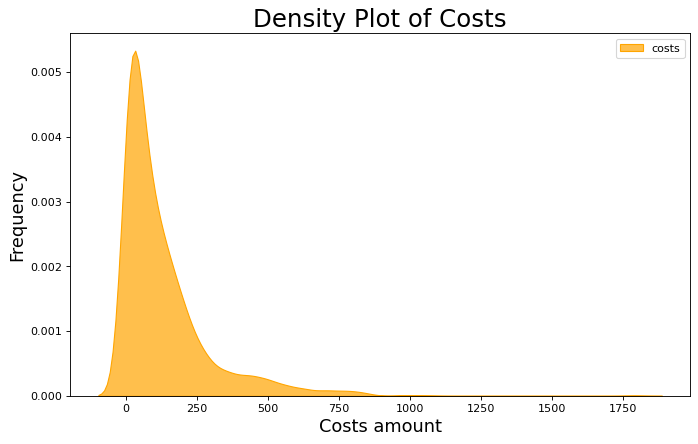

In [24]:
# Drawing plot of costs
plt.figure(figsize=(10,6), dpi= 80)
sns.kdeplot(costs['costs'], shade=True, color="orange", label="costs", alpha=.7)

# Decoration
plt.title('Density Plot of Costs', fontsize=22)

plt.xlabel('Costs amount', fontsize=16)
plt.ylabel('Frequency', fontsize=16)

plt.legend()
plt.show()

Costs are not normally distributed, distribution has a large tail to the right and lots of outliers.
One wisker is longer than the other. Middle 50 % of costs is between 22 to 170 and standard deviation 156.3. There are almost no costs over 1000. Mean value is 129.477 and median value is 77.295.

In [25]:
#stasistical summary of the revenue data
orders['revenue'].describe()

count    50415.000000
mean         4.999647
std         21.818359
min          0.000000
25%          1.220000
50%          2.500000
75%          4.890000
max       2633.280000
Name: revenue, dtype: float64

In [26]:
orders['revenue'].median()

2.5

In [27]:
#stasistical summary of the orders data
fig = px.box(orders, y="revenue", title='Boxplot of Revenue')
fig.show()

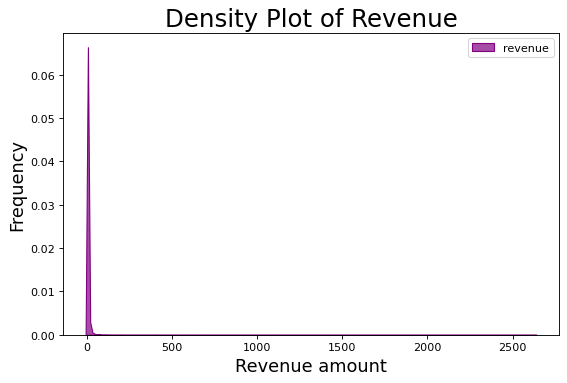

In [28]:
# Drawing plot of revenue
plt.figure(figsize=(8,5), dpi= 80)
sns.kdeplot(orders['revenue'], shade=True, color="purple", label="revenue", alpha=.7)

# Decoration
plt.title('Density Plot of Revenue', fontsize=22)
plt.xlabel('Revenue amount', fontsize=16)
plt.ylabel('Frequency', fontsize=16)

plt.legend()
plt.show()

Revenue is not normally distributed also, we can see a large tail to the right and lots of outliers.
One wisker is longer than the other. Middle 50 % of revenue is between 1.22 and 4.9 with standard deviation of 21.82. Mean value is 4.999 wherease median value is 2.5. 

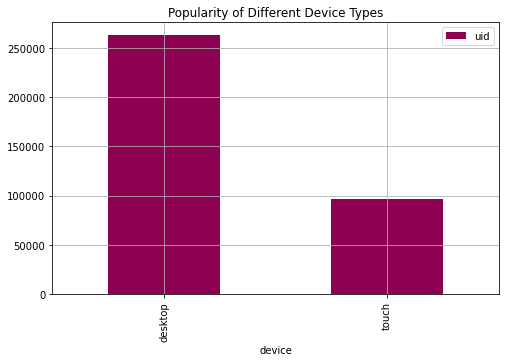

In [29]:
(visits.groupby('device')
 .agg({'uid': 'count'})
 .plot(y='uid', kind='bar', grid=True, figsize=(8,5), cmap='PiYG', title='Popularity of Different Device Types')
)
plt.show()

Afisha seems to be much more popular among those who prefer surfing with desktops.   

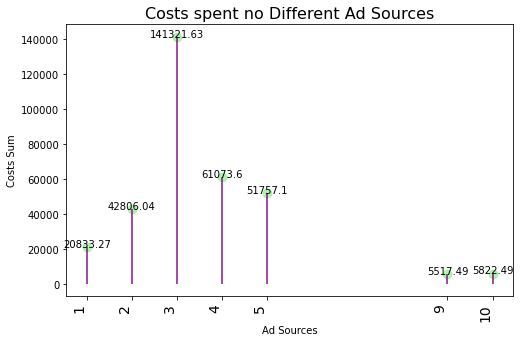

In [30]:
#preparing data 
costs_by_sources = costs.groupby('source_id')['costs'].sum().sort_values().reset_index()
#ploting chart
fig,ax=plt.subplots(figsize=(8,5))
ax.vlines(x=costs_by_sources.source_id, ymin=0, ymax=costs_by_sources.costs, color='purple', alpha=0.7, linewidth=2)
ax.scatter(x=costs_by_sources.source_id, y=costs_by_sources.costs, s=75, color='lightgreen', alpha=0.7)


ax.set_title('Costs spent no Different Ad Sources', fontdict={'size':16})
ax.set_ylabel('Costs Sum')
ax.set_xticks(costs_by_sources.source_id)
ax.set_xticklabels(costs_by_sources.source_id,rotation=90, fontdict={'horizontalalignment':'right','size':14})
ax.set_xlabel('Ad Sources')

for  row in costs_by_sources.itertuples():
    ax.text(row.source_id, row.costs+30,s=round(row.costs,2), rotation=0, fontdict={'horizontalalignment':'center','size':10})

Costs are not evenly disturbuted among ad sources; the company clearly prefers ad source no. 3 to the others. 

<br>Our initial data consisits of 3 tables with information on Afisha site visits (data on 228169 inique users making orders), costs and orders (with data on 36523 unique orders). </br>
<br>The tables have no missing values, vaues with information on date and time  were converted to datetime format. "Device" column were set to category type. Changing object datatypes saved us a lot of memory on device. </br>

<br>Distribution of revenue and costs is positively scewed with lots of outliers. </br>
<br>Afisha has 7 main ad sources and the main one is no. 3, all the others are legging behind. </br>
<br>Afisha's visitors clearly prefer sktops to touch devices. </br>

# Reports and metrics for product, sales and marketing

## Product. How many people use it every day, week, and month.

<br>In this part of the project we will calculate the following metrics:</br>
<br>DAU — the number of daily active (unique) users </br>
<br>WAU — the number of weekly active users</br>
<br>MAU — the number of monthly active users </br>
<br>sticky factor = DAU/WAU </br>
<br>sticky factor = DAU/MAU</br>
<br> Also we will see them in dynamics.</br>

In [31]:
visits['visit_year']  = visits['start_ts'].dt.year
visits['visit_month'] = visits['start_ts'].dt.month
visits['visit_week']  = visits['start_ts'].dt.week
visits['visit_date'] = visits['start_ts'].dt.date
visits.head()

,device,end_ts,source_id,start_ts,uid,visit_year,visit_month,visit_week,visit_date
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062,2017,12,51,2017-12-20
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740,2018,2,8,2018-02-19
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527,2017,7,26,2017-07-01
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214,2018,5,20,2018-05-20
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168,2017,12,52,2017-12-27


In [32]:
dau_total = visits.groupby('visit_date').agg({'uid': 'nunique'}).mean()
wau_total = visits.groupby(['visit_year', 'visit_week']).agg({'uid': 'nunique'}).mean()
mau_total = visits.groupby(['visit_year', 'visit_month']).agg({'uid': 'nunique'}).mean()
print('Average number of daily active (unique) users is', int(dau_total), '.\nAverage number of weekly active (unique) users is', int(wau_total), '. \nAverage number of monthly active users is', int(mau_total), '.')

Average number of daily active (unique) users is 907 .
Average number of weekly active (unique) users is 5716 . 
Average number of monthly active users is 23228 .


Now we will have a look at how MAU and WAU changed with the time.

In [33]:
#plotting MAU chart
mau = visits.groupby(['visit_year', 'visit_month']).agg({'uid': 'nunique'})

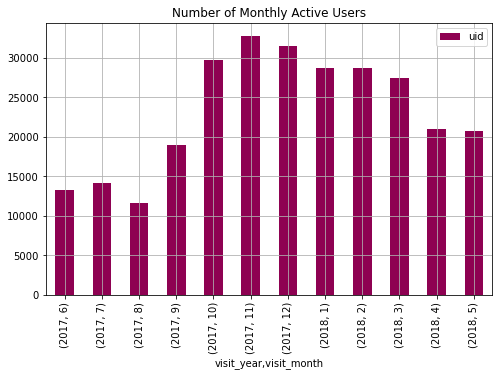

In [34]:
mau.plot(y='uid', kind='bar', grid=True, figsize=(8,5), cmap='PiYG', title='Number of Monthly Active Users')
plt.show()

MAU shows strong seasonal fluctuations: low season is in summer with the least active month in August and high season is in fall-winter with picks starting in October and ending in December.   That can be explained by the fact that tickets to theaters are almost not sold during summer months as theater season usually ends in May and begins again in September - October. We can assume that theater tickets are the main product that visitors to the Afisha site buy there. Moreover population of large cities (the main audience of Afisha) tends to spend summer months outside of the cities and consequently is less active. 

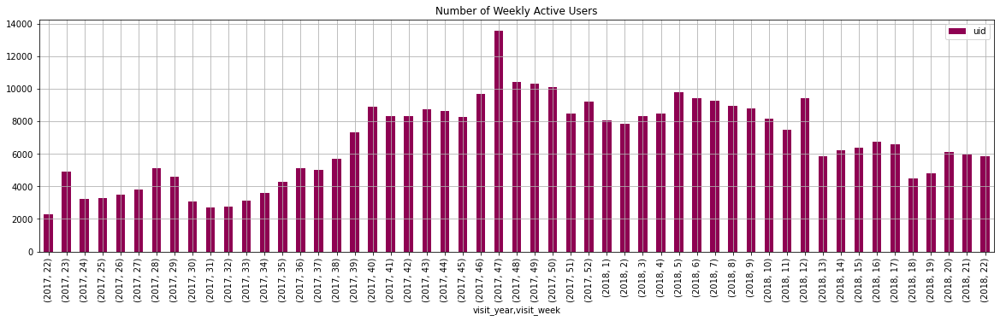

In [35]:
#plotting WAU chart
(visits.groupby(['visit_year', 'visit_week'])
 .agg({'uid': 'count'})
 .plot(y='uid', kind='bar', grid=True, figsize=(20,5), cmap='PiYG', title='Number of Weekly Active Users')
)
plt.show()

WAU parameter also demostrates seasonal fluctuations. But also we can see picks of activity in 2017 (on week 23, week 28, week 40, week 47) and in 2018: week 12. That can be explained by beginning of school vacations and opening of a theater season. 

In [36]:
#calculating avarage values through the whole period 2017-2018.
dau_total = visits.groupby('visit_date').agg({'uid': 'nunique'}).mean()
wau_total = visits.groupby(['visit_year', 'visit_week']).agg({'uid': 'nunique'}).mean()
mau_total = visits.groupby(['visit_year', 'visit_month']).agg({'uid': 'nunique'}).mean()
print('Average number of daily active (unique) users is', int(dau_total), '.\nAverage number of weekly active (unique) users is', int(wau_total), '. \nAverage number of monthly active users is', int(mau_total), '.')

Average number of daily active (unique) users is 907 .
Average number of weekly active (unique) users is 5716 . 
Average number of monthly active users is 23228 .


In [37]:
#calculating avarage values through the period 2017.
dau_2017 = visits.query('visit_year==2017').groupby('visit_date').agg({'uid': 'nunique'}).mean()
wau_2017 = visits.query('visit_year==2017').groupby(['visit_year', 'visit_week']).agg({'uid': 'nunique'}).mean()
mau_2017 = visits.query('visit_year==2017').groupby(['visit_year', 'visit_month']).agg({'uid': 'nunique'}).mean()
print('For 2017:\nAverage number of daily active (unique) users is', int(dau_2017), '.\nAverage number of weekly active (unique) users is', int(wau_2017), '. \nAverage number of monthly active users is', int(mau_2017), '.')

For 2017:
Average number of daily active (unique) users is 845 .
Average number of weekly active (unique) users is 5341 . 
Average number of monthly active users is 21727 .


In [38]:
#calculating avarage values through the period 2018.
dau_2018 = visits.query('visit_year==2018').groupby('visit_date').agg({'uid': 'nunique'}).mean()
wau_2018 = visits.query('visit_year==2018').groupby(['visit_year', 'visit_week']).agg({'uid': 'nunique'}).mean()
mau_2018 = visits.query('visit_year==2018').groupby(['visit_year', 'visit_month']).agg({'uid': 'nunique'}).mean()
print('For 2018:\nAverage number of daily active (unique) users is', int(dau_2018), '.\nAverage number of weekly active (unique) users is', int(wau_2018), '. \nAverage number of monthly active users is', int(mau_2018), '.')

For 2018:
Average number of daily active (unique) users is 997 .
Average number of weekly active (unique) users is 6244 . 
Average number of monthly active users is 25329 .


All 3 parameters demonstrate growth through the period 2017-2018. That means that marketing efforts bring their results. 

Below we will calculate the sticky factor that characterizes audience retention and shows the probability of a newly acquired user to stay in the product. It also shows how good this product retains or “hooks” users.

In [39]:
#calculating sticky factors:
sticky_wau = dau_total/wau_total*100
print('Sticky factor for a week is', int(sticky_wau), '%.')

Sticky factor for a week is 15 %.


That means that for every new user that is brought to the site Afisha has a 15% shot at turning them into a daily user.

In [40]:
sticky_mau = dau_total/mau_total*100
print('Sticky factor for a month is', int(sticky_mau), '%.')

Sticky factor for a month is 3 %.


In [41]:
sticky_mau_2017 = dau_2017/mau_2017*100
print('Sticky factor for a month in 2017 is', int(sticky_mau_2017), '%.')

Sticky factor for a month in 2017 is 3 %.


In [42]:
sticky_mau_2018 = dau_2018/mau_2018*100
print('Sticky factor for a month in 2018 is', int(sticky_mau_2018), '%.')

Sticky factor for a month in 2018 is 3 %.


<br>As both parameters DAU and WAu grew though the year sticky factor stayed at the level of 3%. This is the lowest value this metric can accept and it shows that users do not stay on the site and that it’s Retention Rate is, most likely, low and it doesn’t have a user base required to generate income.  Researches show that there is a correlation between sticky factor and income, which supports the idea of this metric’s influence on product’s financial metrics.</br>
<br> In order to incease sticky factor the following can be helpful:</br>
<br> - better target the audience, </br>
<br> - create valuable and up-to-date content stimulating a user to come back, </br>
<br> - provide convenient interface with lots of useful instruments and features (better UX),</br>
<br> - convenient  app, </br>
<br> - reminders about the product and useful changes (in the form of e-mails or push notifications).</br>

## Product. Sessions per day. 

In [43]:
daily_sessions = visits.groupby('visit_date').agg({'start_ts': 'count'}).describe()
daily_sessions

,start_ts
count,364.000000
mean,987.362637
std,418.994796
min,1.000000
25%,635.500000
50%,1003.000000
75%,1280.000000
max,4042.000000


In [44]:
daily_sessions["start_ts"].median()

811.4313186813187

In [45]:
fig = px.box(daily_sessions, y="start_ts", title='Boxplot of daily sessions')
fig.show()

In [46]:
daily_sessions = visits.groupby('visit_date').agg({'start_ts': 'count'}).reset_index()
daily_sessions

,visit_date,start_ts
0,2017-06-01,664
1,2017-06-02,658
2,2017-06-03,477
3,2017-06-04,510
4,2017-06-05,893
...,...,...
359,2018-05-27,672
360,2018-05-28,1156
361,2018-05-29,1035
362,2018-05-30,1410


In [47]:
#visualizing the results
fig = px.histogram(daily_sessions, x="start_ts", title='Distribution of daily sessions number')
fig.show()

In average site has 987 visits per day. Middle 50% is between 636 and 1280 visits per day, median value is 811 visits with standard deviation of 419. Distribution is not normal, the wiskers are not equal and there is a tail to the right with some outliers. Most of the distribution falls into interval between 300-400 and 1500-1600 visits. 

We will have a look at the visits data in dynamic. 

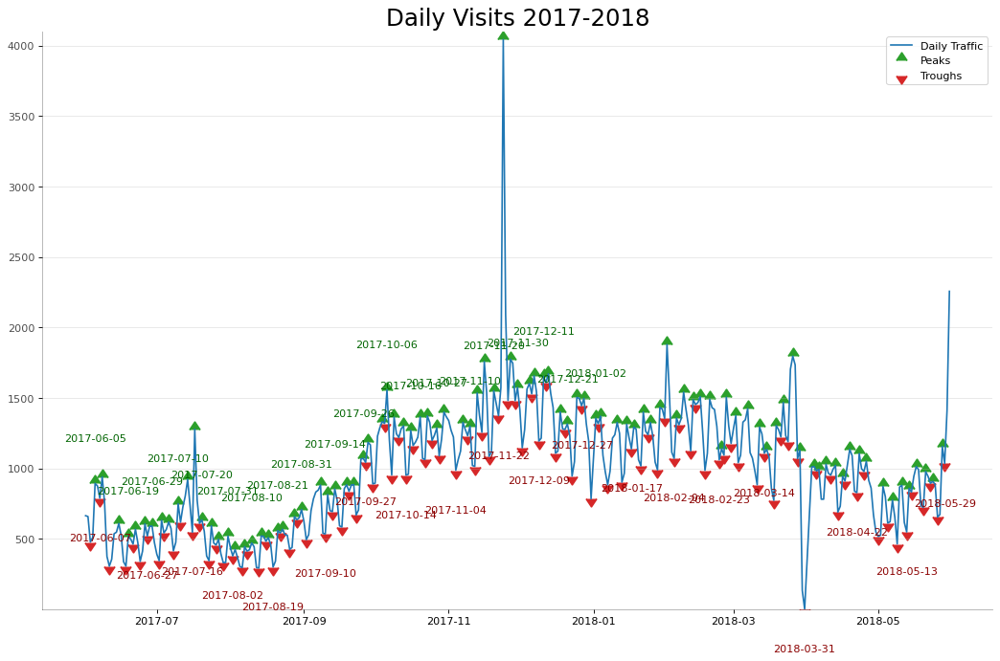

In [48]:

# Get the Peaks and Troughs
data = daily_sessions['start_ts'].values
doublediff = np.diff(np.sign(np.diff(data)))
peak_locations = np.where(doublediff == -2)[0] + 1

doublediff2 = np.diff(np.sign(np.diff(-1*data)))
trough_locations = np.where(doublediff2 == -2)[0] + 1

# Draw Plot
plt.figure(figsize=(16,10), dpi= 80)
plt.plot('visit_date', 'start_ts', data=daily_sessions, color='tab:blue', label='Daily Traffic')
plt.scatter(daily_sessions.visit_date[peak_locations], daily_sessions.start_ts[peak_locations], marker=mpl.markers.CARETUPBASE, color='tab:green', s=100, label='Peaks')
plt.scatter(daily_sessions.visit_date[trough_locations], daily_sessions.start_ts[trough_locations], marker=mpl.markers.CARETDOWNBASE, color='tab:red', s=100, label='Troughs')

# Annotate
for t, p in zip(trough_locations[1::5], peak_locations[::3]):
    plt.text(daily_sessions.visit_date[p], daily_sessions.start_ts[p]+300, daily_sessions.visit_date[p], horizontalalignment='center', color='darkgreen')
    plt.text(daily_sessions.visit_date[t], daily_sessions.start_ts[t]-300, daily_sessions.visit_date[t], horizontalalignment='center', color='darkred')

# Decoration
plt.ylim(1,4100)
#xtick_location = daily_sessions.index.tolist()[::2]
#xtick_labels = daily_sessions.visit_date.tolist()[::2]
#plt.xticks(ticks=xtick_location, labels=xtick_labels, rotation=90, fontsize=12, alpha=.7)
plt.title("Daily Visits 2017-2018", fontsize=22)
plt.yticks(fontsize=10, alpha=.7)

# Lighten borders
plt.gca().spines["top"].set_alpha(.0)
plt.gca().spines["bottom"].set_alpha(.3)
plt.gca().spines["right"].set_alpha(.0)
plt.gca().spines["left"].set_alpha(.3)

plt.legend(loc='upper right')
plt.grid(axis='y', alpha=.3)
plt.show()

Dynamic of number of daily sessions proves that users are more active during autumn and winter periods. Probably Afisha should add some additional products and offers to rise summer activity on the site.  

Below we will check the daily dynamics for 2 types of devices, desktop and touch.

In [49]:
#Grouping the data and creation a pivot table for plotting the chart.
daily_sessions_device = visits.groupby(['visit_date', 'device']).agg({'start_ts': 'count'}).reset_index()
daily_sessions_device = daily_sessions_device.rename(columns={'start_ts': 'user_visits'})
device_pivot = daily_sessions_device.pivot(index='visit_date',columns='device',values='user_visits')

device_pivot.head()

device,desktop,touch
visit_date,,
2017-06-01,501,163
2017-06-02,498,160
2017-06-03,329,148
2017-06-04,349,161
2017-06-05,693,200


In [50]:
device_pivot['desktop'].mean()

721.3379120879121

In [51]:
device_pivot['touch'].mean()

266.02472527472526

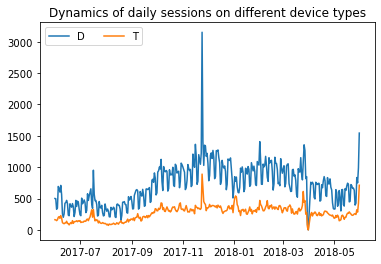

In [52]:
plt.plot(device_pivot)
plt.rcParams["figure.figsize"] = (18,13)
plt.title('Dynamics of daily sessions on different device types')
ax.set_ylabel('Number of sessions')
ax.set_xlabel('Dates')
plt.legend('DT', ncol=2, loc='upper left');

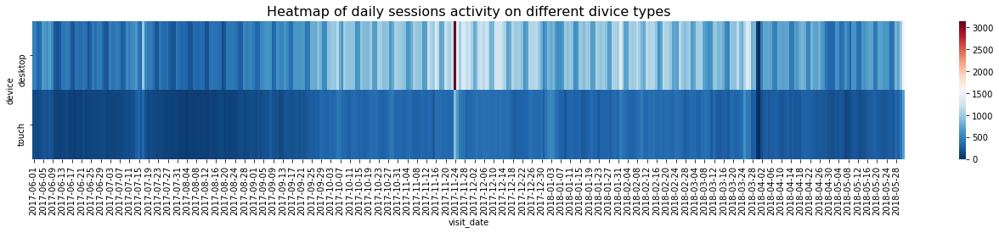

In [53]:
plt.figure(figsize=(23,3))
sns.heatmap(device_pivot.T, cmap="RdBu_r")
plt.title("Heatmap of daily sessions activity on different divice types", fontsize =16)
plt.show()

The number of visits through touch devices is significantly lower than the desktop ones as we saw it previously. General trends (such as seasonal peaks and traughs) are common for both device types.  Although touch users demonstrate less fluctuation during the period. 

In [54]:
print(device_pivot.query('touch==890'))

device      desktop  touch
visit_date                
2017-11-24     3152    890


We have checked the day with maximum sessions number (24.11.2017) but have not found any specific reason for such abnormal activity in the news archieve. There may be a lot pf reasons including a failure in site logging system or Afisha might have run some special ad campaign or it have been mentioned somewhere. As this data does not have any significant impact on the purpose of our analysis we have left it out.

## Product. What is the length of each session?

In [55]:
visits['session_length_sec'] = (visits['end_ts'] - visits['start_ts']).dt.seconds
visits['session_length_sec'].describe()

count    359400.000000
mean        643.506489
std        1016.334786
min           0.000000
25%         120.000000
50%         300.000000
75%         840.000000
max       84480.000000
Name: session_length_sec, dtype: float64

In [56]:
#calculating an average session length, ASL
print(visits['session_length_sec'].median())

300.0


In [57]:
visits['session_length_sec'].mode()

0    60
dtype: int64

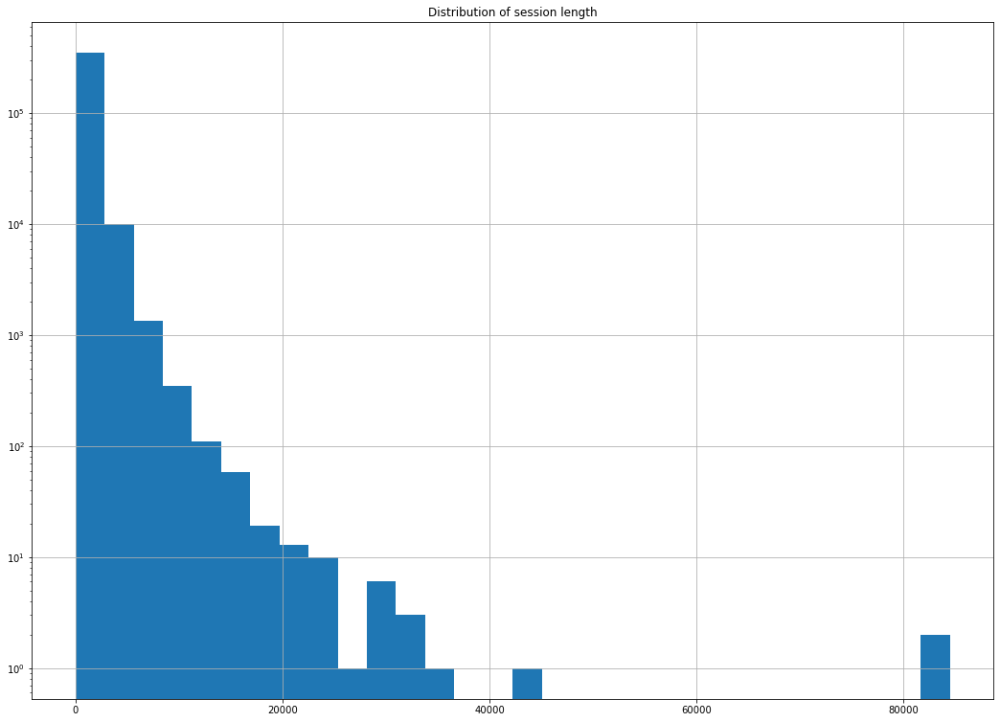

In [58]:
visits['session_length_sec'].hist(bins=30, log=True)
plt.title('Distribution of session length')
plt.show()

Middle 50% of sessions are from 120 to 840 sec. Magority of sessions have length up to 2000-3000 sec. Still the histogram shows that there are some outliers with sessions over 40,000 and 80,000 sec. 

As customer behavior differs for touch devices and for desktops, we will check this parameter for 2 types of sessions separately. 

In [59]:
visits_touch = visits.query('device=="touch"')
visits_touch['session_length_sec'].describe()

count    96833.000000
mean       479.619407
std        752.531533
min          0.000000
25%         60.000000
50%        180.000000
75%        600.000000
max      30840.000000
Name: session_length_sec, dtype: float64

In [60]:
visits_desktop = visits.query('device=="desktop"')
visits_desktop['session_length_sec'].describe()

count    262567.000000
mean        703.946977
std        1091.545596
min           0.000000
25%         120.000000
50%         360.000000
75%         900.000000
max       84480.000000
Name: session_length_sec, dtype: float64

In [61]:
fig = px.box(visits, x="device", y="session_length_sec", color="device", title='Boxplot of sessions length for two device types')
fig.show()

<br>Range of the sessions length is quite big: from 0 to 84,480 seconds per session. An average session length (ASL) regardless type of device is 643.5 sec. Median value is 300 seconds. As distribution is positively scewed with a long tail to the right, median value will be more informative. Standard deviation is 1016.33. Middle 50% of sessions are from 120 to 840 sec. </br>
<br>Median value for touch devices is shorter by 1/3, among desktop users much more those who spend on the site over 2040 sec. (upper fence). Ether app is more convinient or site is more interesting. </br>
<br>Mostly sessions are very short. There are almost no sessions over 5000 sec (1.50 hours). We can assume that users come for some specific information and that time is enough to check the necessary event and order tickets.</br>
<br>Presumably that means that UX is good. On the other hand it can be a signal that site or app do not hook users with additional info or offers. </br>

## Product. How often do users come back?

In [62]:
#defining first activity date per user:
visits['start_ts'] = pd.to_datetime(visits['start_ts'])
first_activity_date = visits.groupby(['uid'])['start_ts'].min()
first_activity_date.name = 'first_activity_date'
user_activity = visits.join(first_activity_date,on='uid')
user_activity['first_activity_date'] = pd.to_datetime(user_activity['first_activity_date'])
user_activity.head()

,device,end_ts,source_id,start_ts,uid,visit_year,visit_month,visit_week,visit_date,session_length_sec,first_activity_date
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062,2017,12,51,2017-12-20,1080,2017-12-20 17:20:00
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740,2018,2,8,2018-02-19,1680,2018-02-19 16:53:00
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527,2017,7,26,2017-07-01,0,2017-07-01 01:54:00
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214,2018,5,20,2018-05-20,1440,2018-03-09 20:05:00
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168,2017,12,52,2017-12-27,0,2017-12-27 14:06:00


In [63]:
#defining cohort lifetime (months)
user_activity['start_ts'] = user_activity['start_ts'].astype('datetime64[M]')
user_activity['activity_month'] = pd.to_datetime(user_activity['start_ts'], unit='d') - pd.to_timedelta(user_activity['start_ts'].dt.dayofweek, unit='d')
user_activity['first_activity_month'] = pd.to_datetime(user_activity['first_activity_date'], unit='d') - pd.to_timedelta(user_activity['first_activity_date'].dt.dayofweek, unit='d')
user_activity['first_activity_month'] = user_activity['first_activity_month'].astype('datetime64[M]')
user_activity['cohort_lifetime'] = user_activity['activity_month'] - user_activity['first_activity_month']
user_activity['cohort_lifetime'] = user_activity['cohort_lifetime'] / np.timedelta64(1,'M')
user_activity['cohort_lifetime'] = user_activity['cohort_lifetime'].round().astype(int)
user_activity.head()

,device,end_ts,source_id,start_ts,uid,visit_year,visit_month,visit_week,visit_date,session_length_sec,first_activity_date,activity_month,first_activity_month,cohort_lifetime
0,touch,2017-12-20 17:38:00,4,2017-12-01,16879256277535980062,2017,12,51,2017-12-20,1080,2017-12-20 17:20:00,2017-11-27,2017-12-01,0
1,desktop,2018-02-19 17:21:00,2,2018-02-01,104060357244891740,2018,2,8,2018-02-19,1680,2018-02-19 16:53:00,2018-01-29,2018-02-01,0
2,touch,2017-07-01 01:54:00,5,2017-07-01,7459035603376831527,2017,7,26,2017-07-01,0,2017-07-01 01:54:00,2017-06-26,2017-06-01,1
3,desktop,2018-05-20 11:23:00,9,2018-05-01,16174680259334210214,2018,5,20,2018-05-20,1440,2018-03-09 20:05:00,2018-04-30,2018-03-01,2
4,desktop,2017-12-27 14:06:00,3,2017-12-01,9969694820036681168,2017,12,52,2017-12-27,0,2017-12-27 14:06:00,2017-11-27,2017-12-01,0


In [64]:
#checking calculations
negative_lifetime = user_activity.query('cohort_lifetime<0')
negative_lifetime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 0 entries
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   device                0 non-null      category      
 1   end_ts                0 non-null      datetime64[ns]
 2   source_id             0 non-null      int64         
 3   start_ts              0 non-null      datetime64[ns]
 4   uid                   0 non-null      uint64        
 5   visit_year            0 non-null      int64         
 6   visit_month           0 non-null      int64         
 7   visit_week            0 non-null      int64         
 8   visit_date            0 non-null      object        
 9   session_length_sec    0 non-null      int64         
 10  first_activity_date   0 non-null      datetime64[ns]
 11  activity_month        0 non-null      datetime64[ns]
 12  first_activity_month  0 non-null      datetime64[ns]
 13  cohort_lifetime       0 non-null

In [65]:
#grouping in cohorts
cohorts = user_activity.groupby(['first_activity_month','cohort_lifetime']).agg({'uid':'nunique'}).reset_index()
initial_users_count = cohorts[cohorts['cohort_lifetime'] == 0][['first_activity_month','uid']]
initial_users_count = initial_users_count.rename(columns={'uid':'cohort_users'})
cohorts = cohorts.merge(initial_users_count,on='first_activity_month')
cohorts['retention'] = cohorts['uid']/cohorts['cohort_users']
cohorts.head()

,first_activity_month,cohort_lifetime,uid,cohort_users,retention
0,2017-06-01,0,11238,11238,1.000000
1,2017-06-01,1,1434,11238,0.127603
2,2017-06-01,2,587,11238,0.052233
3,2017-06-01,3,667,11238,0.059352
4,2017-06-01,4,737,11238,0.065581


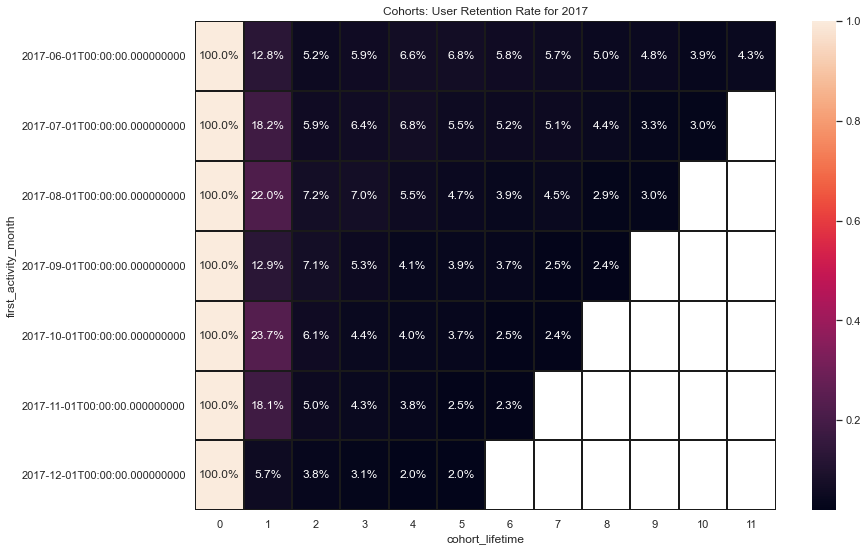

In [66]:
cohorts_2017 = cohorts[cohorts['first_activity_month'].dt.year == 2017].reset_index()
 
#heatmap for 2017
retention_pivot_2017 = cohorts_2017.pivot_table(index='first_activity_month',columns='cohort_lifetime',values='retention',aggfunc='sum')
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('Cohorts: User Retention Rate for 2017')
sns.heatmap(retention_pivot_2017, annot=True, fmt='.1%', linewidths=1, linecolor='k');

Monthly retetnion rate shows that in 2017 from 6% to 23% of users Afisha retained in a month after the 1st visit. The highest retention rates were among users that came in August and in October (22% and 24% respectively). In the following months their retention rate fell dramatically (to 7% and 6%) and remained low. The lowest retention rate was among  users that came in December (6%). RR was at the level of 2-4% for all cohorts by the end of the period. These values are not high.  

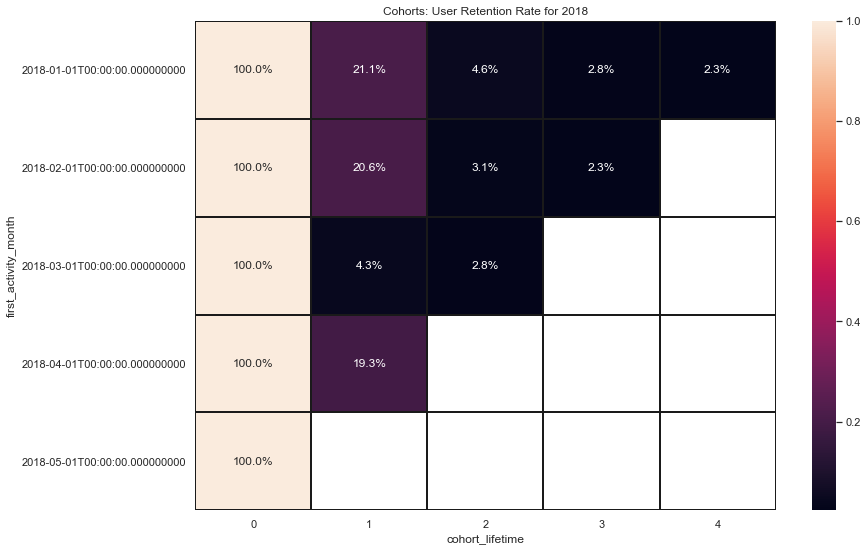

In [67]:
#for year 2018
cohorts_2018 = cohorts[cohorts['first_activity_month'].dt.year == 2018].reset_index()
retention_pivot_2018 = cohorts_2018.pivot_table(index='first_activity_month',columns='cohort_lifetime',values='retention',aggfunc='sum')
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('Cohorts: User Retention Rate for 2018')
sns.heatmap(retention_pivot_2018, annot=True, fmt='.1%', linewidths=1, linecolor='k');

In [68]:
#defining median value of retantion rate(2017):
cohorts_2017['retention'].median()

0.05141265419816952

In [69]:
#defining median value of retantion rate (2018):
cohorts_2018['retention'].median()

0.1931376917690496

In 2018 the highest retention rates were among users that came in January, February and April (21%, 21% and 19% respectively). They are followed by the strong decline as well. March cohort looks like a lame one with only 4% of visitors coming back in the first month. Such situation (just like in December 2017) might be caused by poorly targeted marketing campain that brought untargeted audience to the site. 

#### Conclusion.
<br>Afisha's visitors demonstrate strong seasonal fluctuation with low season in summer and high season in fall-winter with picks starting in October and ending in December. We can see that analysing MAU, DAU and WAU values. </br>
<br>We can see also that on average number of Afisha's visits grow through the time.  MAU have seen a growth by 17% in 2018 in comparison to 2017. Stick factor is relatively low, that shows that users do not stay on the site. </br>
<br>Average number of sessions per day on the site is 811 (median value) with middle 50% is between 636 and 1280 visits per day. 
<br>The number of visits via touch devices is significantly lower than via desktop ones: 266 vs 721. </br>
<br>General trends (such as seasonal peaks and traughs) are common for both device types, although touch users demonstrate less fluctuations during the period.</br>

<br>An average session length (ASL) regardless type of device is 643.5 sec. A median value of session length for touch devices visits is shorter than desktop ones (180 sec vs 360 sec). Distibution of desctop devices sessions has larger tail to the right with bigger number of outliers. </br>
<br>We can see that Afisha's customers prefer to use desctope devices and stay on the site longer than with the app. </br>

<br>An average retantion rate is not high but has grown from 5% in 2017 to 19% in 2018. In 2017 the highest retention rates were among users that came in August and in October (every 5th user came back next month). The lowest retention rate was among users that came in December (only 6% of users came back next month). </br>
In 2018 the most loyal were users of January, February and April cohorts. Cohorts of both years demonstrate retention rate of 2-3% by the end of their lifetime period. </br>


<br>In general we can see that almost every 5th visitor that came to Afisha site tend to come back in a month. Although the next month retantion rate falls down to the level of 4-7% which is quite a drastic fall.  </br>
<br>Afisha might think of some marketing compaigns and offers to make visitors keep coming back during longer period of time as it is easer and cheaper to make a visitor come back than to bring a new one. </br>

## Sales. When people start buying. 

We are going to join data from 2 tables (visits and orders) to define the difference between time of the first visit and the first order breaking the results by ad source id and by cohorts.

In [70]:
visits_for_merge = visits[['uid', 'start_ts', 'end_ts', 'source_id', 'device']]
visits_for_merge.head()

,uid,start_ts,end_ts,source_id,device
0,16879256277535980062,2017-12-20 17:20:00,2017-12-20 17:38:00,4,touch
1,104060357244891740,2018-02-19 16:53:00,2018-02-19 17:21:00,2,desktop
2,7459035603376831527,2017-07-01 01:54:00,2017-07-01 01:54:00,5,touch
3,16174680259334210214,2018-05-20 10:59:00,2018-05-20 11:23:00,9,desktop
4,9969694820036681168,2017-12-27 14:06:00,2017-12-27 14:06:00,3,desktop


In [71]:
visits['uid'].nunique()

228169

In [72]:
orders_for_merge = orders[['uid', 'buy_ts', 'revenue']]
orders_for_merge.head()

,uid,buy_ts,revenue
0,10329302124590727494,2017-06-01 00:10:00,17.00
1,11627257723692907447,2017-06-01 00:25:00,0.55
2,17903680561304213844,2017-06-01 00:27:00,0.37
3,16109239769442553005,2017-06-01 00:29:00,0.55
4,14200605875248379450,2017-06-01 07:58:00,0.37


In [73]:
orders_for_merge['uid'].nunique()

36523

In [74]:
#merging the tables and dropping duplicates
orders_visits = pd.merge(orders_for_merge, visits_for_merge.drop_duplicates(subset=['uid']),how='inner').query('buy_ts>start_ts')
         
orders_visits

,uid,buy_ts,revenue,start_ts,end_ts,source_id,device
0,10329302124590727494,2017-06-01 00:10:00,17.00,2017-06-01 00:09:00,2017-06-01 00:11:00,1,desktop
1,11627257723692907447,2017-06-01 00:25:00,0.55,2017-06-01 00:14:00,2017-06-01 00:25:00,2,desktop
2,17903680561304213844,2017-06-01 00:27:00,0.37,2017-06-01 00:25:00,2017-06-01 00:34:00,2,desktop
3,16109239769442553005,2017-06-01 00:29:00,0.55,2017-06-01 00:14:00,2017-06-01 00:33:00,2,desktop
4,14200605875248379450,2017-06-01 07:58:00,0.37,2017-06-01 07:31:00,2017-06-01 07:59:00,3,desktop
...,...,...,...,...,...,...,...
50410,12296626599487328624,2018-05-31 23:50:00,4.64,2018-05-31 23:46:00,2018-06-01 00:13:00,4,desktop
50411,11369640365507475976,2018-05-31 23:50:00,5.80,2018-05-31 23:05:00,2018-05-31 23:55:00,10,desktop
50412,1786462140797698849,2018-05-31 23:54:00,0.30,2018-05-31 23:52:00,2018-05-31 23:55:00,3,desktop
50413,3993697860786194247,2018-05-31 23:56:00,3.67,2018-01-15 10:39:00,2018-01-15 10:47:00,4,desktop


In [75]:
#defining first order date
orders_visits['buy_ts']=pd.to_datetime(orders_visits['buy_ts'])
first_order_date_by_customers = orders_visits.groupby('uid')['buy_ts'].min()
first_order_date_by_customers.name = 'first_order_date_by_customers'
#first_order_date_by_customers
orders_visits = orders_visits.join(first_order_date_by_customers,on='uid')
orders_visits['first_order_date'] = orders_visits['first_order_date_by_customers'].values.astype('datetime64[D]')

In [76]:
#defining first visit date
orders_visits['start_ts']=pd.to_datetime(orders_visits['start_ts'])
first_visit_date = orders_visits.groupby('uid')['start_ts'].min()

first_activity_date = orders_visits.groupby(['uid'])['start_ts'].min()
first_activity_date.name = 'first_activity_date'

orders_visits = orders_visits.join(first_activity_date,on='uid')
orders_visits['first_activity_date'] = orders_visits['first_activity_date'].values.astype('datetime64[D]')

In [77]:
#calculating how many days it takes to order after the fiirst visit
orders_visits['time_to_conversion'] = orders_visits['first_order_date'] - orders_visits['first_activity_date']
orders_visits['time_to_conversion'] = (orders_visits['time_to_conversion']/ np.timedelta64(1,'D')).astype(int)
orders_visits.head()

,uid,buy_ts,revenue,start_ts,end_ts,source_id,device,first_order_date_by_customers,first_order_date,first_activity_date,time_to_conversion
0,10329302124590727494,2017-06-01 00:10:00,17.00,2017-06-01 00:09:00,2017-06-01 00:11:00,1,desktop,2017-06-01 00:10:00,2017-06-01,2017-06-01,0
1,11627257723692907447,2017-06-01 00:25:00,0.55,2017-06-01 00:14:00,2017-06-01 00:25:00,2,desktop,2017-06-01 00:25:00,2017-06-01,2017-06-01,0
2,17903680561304213844,2017-06-01 00:27:00,0.37,2017-06-01 00:25:00,2017-06-01 00:34:00,2,desktop,2017-06-01 00:27:00,2017-06-01,2017-06-01,0
3,16109239769442553005,2017-06-01 00:29:00,0.55,2017-06-01 00:14:00,2017-06-01 00:33:00,2,desktop,2017-06-01 00:29:00,2017-06-01,2017-06-01,0
4,14200605875248379450,2017-06-01 07:58:00,0.37,2017-06-01 07:31:00,2017-06-01 07:59:00,3,desktop,2017-06-01 07:58:00,2017-06-01,2017-06-01,0


In [78]:
orders_visits['time_to_conversion'].describe()

count    37323.000000
mean        12.420599
std         38.958894
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max        357.000000
Name: time_to_conversion, dtype: float64

In [79]:
orders_visits['time_to_conversion'].value_counts()

0      26551
1       1915
2        741
3        661
4        589
       ...  
247        1
348        1
329        1
310        1
295        1
Name: time_to_conversion, Length: 319, dtype: int64

In [80]:
#adding a column with category of conversion
def conversion(days):  
    if days == 0:
        return '1_conversion_0d'
    if days > 0 and days <= 7:
        return '2_conversion_7d'
    if days > 7 and days <= 14:
        return '3_conversion_14d'
    if days > 14 and days <= 21:
        return '4_conversion_21d'
    if days > 21 and days <= 30:
        return '5_conversion_30d'
    if days > 30 and days <= 60:
        return '6_conversion_2nd_m'
    return '7_over_2months'

orders_visits['conversion_category'] = orders_visits['time_to_conversion'].apply(conversion)
orders_visits['conversion_category'].value_counts()

1_conversion_0d       26551
2_conversion_7d        4683
7_over_2months         2625
6_conversion_2nd_m     1306
3_conversion_14d        955
4_conversion_21d        667
5_conversion_30d        536
Name: conversion_category, dtype: int64

In order to group by cohorts we will define cohort lifetime:

In [81]:
#defining cohort lifetime (months)
orders_visits['start_ts'] = orders_visits['start_ts'].astype('datetime64[M]')
orders_visits['activity_month'] = pd.to_datetime(orders_visits['start_ts'], unit='d') - pd.to_timedelta(orders_visits['start_ts'].dt.dayofweek, unit='d')
orders_visits['first_activity_month'] = pd.to_datetime(orders_visits['first_activity_date'], unit='d') - pd.to_timedelta(orders_visits['first_activity_date'].dt.dayofweek, unit='d')
orders_visits['first_activity_month'] = orders_visits['first_activity_month'].astype('datetime64[M]')
orders_visits['cohort_lifetime'] = orders_visits['activity_month'] - orders_visits['first_activity_month']
orders_visits['cohort_lifetime'] = orders_visits['cohort_lifetime'] / np.timedelta64(1,'M')
orders_visits['cohort_lifetime'] = orders_visits['cohort_lifetime'].round().astype(int)


In [82]:
#grouping in cohorts
cohorts_conversion = orders_visits.groupby(['first_activity_month','cohort_lifetime']).agg({'uid':'nunique', 'time_to_conversion':'mean'}).reset_index()

initial_users_count1 = cohorts_conversion[cohorts_conversion['cohort_lifetime'] == 0][['first_activity_month','uid']]
initial_users_count1 = initial_users_count1.rename(columns={'uid':'cohort_users'})
cohorts_conversion = cohorts_conversion.merge(initial_users_count1,on='first_activity_month')

cohorts_conversion.head()

,first_activity_month,cohort_lifetime,uid,time_to_conversion,cohort_users
0,2017-06-01,0,1478,33.500821,1478
1,2017-06-01,1,59,49.432432,1478
2,2017-07-01,0,1562,30.593943,1562
3,2017-07-01,1,170,23.764192,1562
4,2017-08-01,0,1028,30.126285,1028


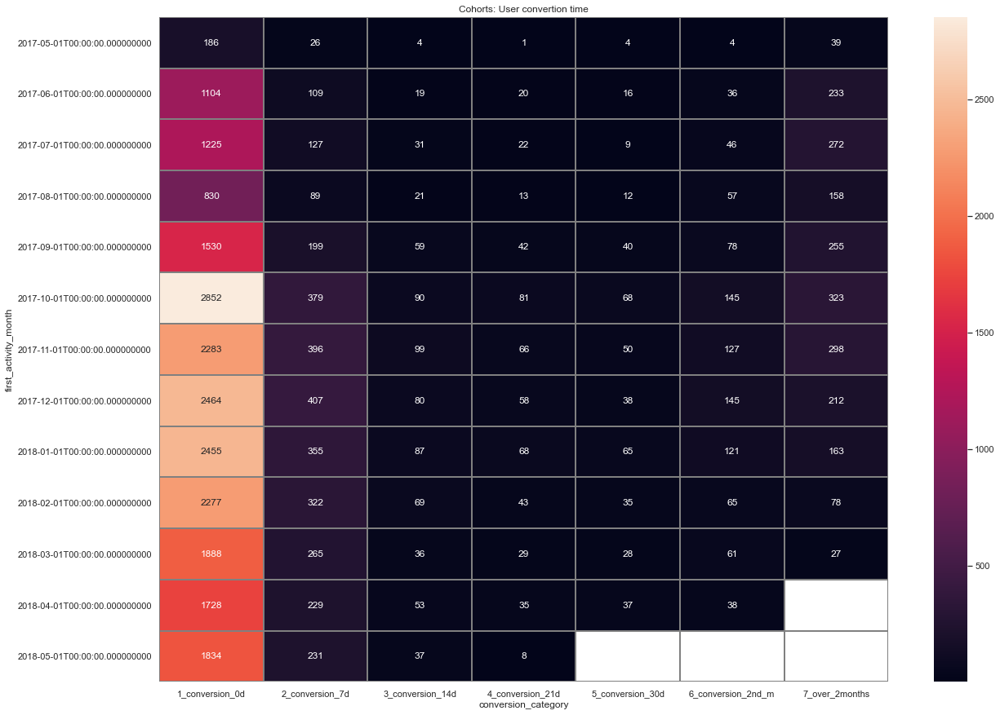

In [83]:
pivot_conversion_general = orders_visits.pivot_table(index='first_activity_month',columns='conversion_category',values='uid',aggfunc='nunique')
sns.set(style='white')
plt.figure(figsize=(20, 15))
plt.title('Cohorts: User convertion time')
sns.heatmap(pivot_conversion_general, annot=True, fmt='g', linewidths=1, linecolor='grey');

<br>Conversion during the day of the first visit is the most often situation among those visitors who buy something from Afisha site. The biggest number of 'd0' converted visitors came in October, December and January. </br>
<br>Less people buy during the week after their first visit. The most active stayed the same cohorts of October, December and January plus November one.</br> 
<br>Number of people that buy during the following weeks of the first month is much lower and keep decreasing towards the end of the 1st month. During the 2nd month visitors bought aproximately as much as during the last 2 weeks of the 1st month. After 2nd month since the first visit mostly kept buying visitors from cohort of June, July, September, October and November. </br>
<br>It looks like ad compaigns that brought visitors of October ,November and December cohorts were the best targeted ones. </br>

Next we will look at the conversion time by the ad sources.

First we will analyse an average conversion time by the ad sources.

In [84]:
conversion_grouped_by_sourses = orders_visits.groupby(['source_id']).agg({'time_to_conversion':'mean'}).sort_values(by='time_to_conversion', ascending=True).reset_index()
conversion_grouped_by_sourses['source_id'] = conversion_grouped_by_sourses['source_id'].astype(str)
conversion_grouped_by_sourses.reset_index(drop=True)

,source_id,time_to_conversion
0,7,0.000000
1,10,9.279376
2,1,9.612333
3,5,10.126134
4,4,12.441176
5,3,12.907858
6,2,14.564228
7,9,27.404762


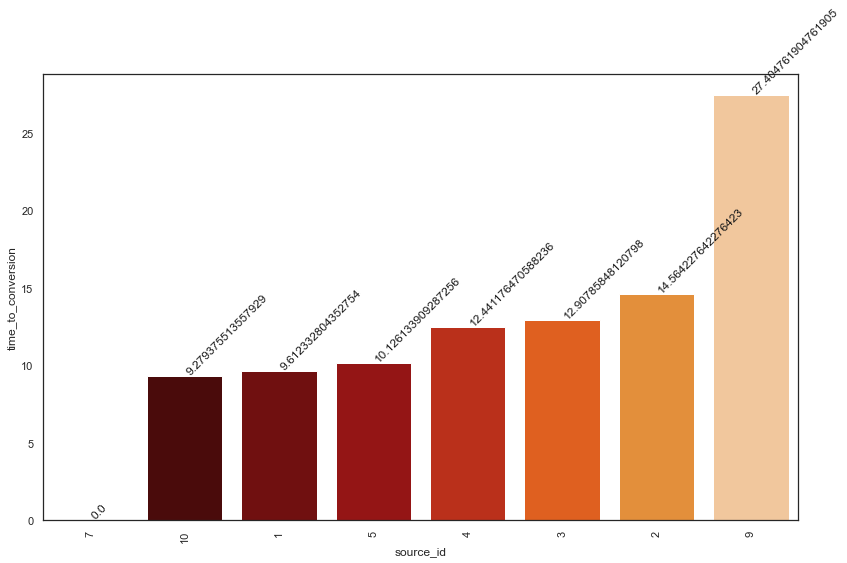

In [85]:
#plotting a barchart for conversion time by ad sources, days

plt.figure(figsize=(12,8))

# plot barh chart with index as x values
ax = sns.barplot(conversion_grouped_by_sourses.index, conversion_grouped_by_sourses.time_to_conversion, palette="gist_heat")
ax.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))
ax.set(xlabel="source_id", ylabel='time_to_conversion')

ax.set_xticklabels(conversion_grouped_by_sourses.source_id)
for item in ax.get_xticklabels(): item.set_rotation(90)
for i, v in enumerate(conversion_grouped_by_sourses["time_to_conversion"].iteritems()):        
    ax.text(i ,v[1], "{:,}".format(v[1]), color='k', va ='bottom', rotation=45)
plt.tight_layout()
plt.show()

On average visitors that came from ad sources no. 10, 1 and 5 make a purchase in 9-10 days; those from ad sources no. 2, 3 and 4 make a purchase in 12-14 days, and the longest it take for those who came from ad sources no. 9 (it's almost a month).

Now we will analyse the how many visitors from different sources converted within certain time periods. 

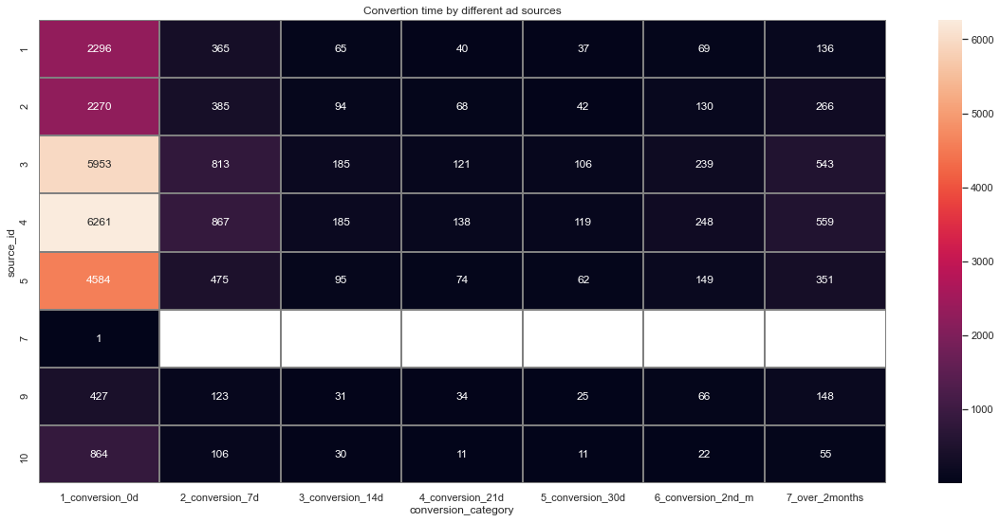

In [86]:
#grouping by ad source
pivot_conversion_source = orders_visits.pivot_table(index='source_id',columns='conversion_category',values='uid',aggfunc='nunique')
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Convertion time by different ad sources')
sns.heatmap(pivot_conversion_source, annot=True, fmt='g', linewidths=1, linecolor='grey');

<br>Ad sources no. 4 , 3 and 5 brought the most visitors that made orders during the day of their first visit. Big amount of these visitors kept converted during the following week and were active even after two months after their first visit. </br>
<br>Ad sources no. 1 and 2 look equally effective. Visitors from these sources also keep buying during a week after their first visit. Visitors from source no. 2 were twice more active than the ones from source no. 1 after the 2nd month.  </br>
<br>The least effective ad source is no. 9. But relaitively big share of visitors kept converted during the following period of time using this ad source.</br>
<br>Ad sources no. 7 has brought only 1 conversion. </br>


Next we will check how soon the users make an order during one session.

In [87]:
#merging the tables to get info only on visits with orders to look at them in details.
merged = orders_for_merge.merge(visits_for_merge, on='uid', how='inner').query('start_ts<=buy_ts<=end_ts')
merged

,uid,buy_ts,revenue,start_ts,end_ts,source_id,device
0,10329302124590727494,2017-06-01 00:10:00,17.00,2017-06-01 00:09:00,2017-06-01 00:11:00,1,desktop
1,11627257723692907447,2017-06-01 00:25:00,0.55,2017-06-01 00:14:00,2017-06-01 00:25:00,2,desktop
2,17903680561304213844,2017-06-01 00:27:00,0.37,2017-06-01 00:25:00,2017-06-01 00:34:00,2,desktop
3,16109239769442553005,2017-06-01 00:29:00,0.55,2017-06-01 00:14:00,2017-06-01 00:33:00,2,desktop
4,14200605875248379450,2017-06-01 07:58:00,0.37,2017-06-01 07:31:00,2017-06-01 07:59:00,3,desktop
...,...,...,...,...,...,...,...
761790,15854392578508828030,2018-05-31 23:42:00,0.92,2018-05-31 23:26:00,2018-05-31 23:47:00,4,touch
761798,12296626599487328624,2018-05-31 23:50:00,4.64,2018-05-31 23:46:00,2018-06-01 00:13:00,4,desktop
761800,11369640365507475976,2018-05-31 23:50:00,5.80,2018-05-31 23:05:00,2018-05-31 23:55:00,10,desktop
761801,1786462140797698849,2018-05-31 23:54:00,0.30,2018-05-31 23:52:00,2018-05-31 23:55:00,3,desktop


We have lost 596 entries during the merge in comparison to the size of 'orders_for_merge' db. That might mean that either visits df does not contain all the data on visits with orders or some rows had entry errors and quiery condition was not met. We will perform the calculations with the valid data that we got.

In [88]:
#defining date of the activity date
merged['start_ts'] = pd.to_datetime(merged['start_ts'])
merged['buy_ts'] = pd.to_datetime(merged['buy_ts'])
merged['end_ts'] = pd.to_datetime(merged['end_ts'])
first_activity_date1 = merged.groupby(['uid'])['start_ts'].min()
first_activity_date1.name = 'first_activity_date'
user_activity1 = merged.join(first_activity_date1,on='uid')
user_activity1['first_activity_date'] = pd.to_datetime(user_activity1['first_activity_date'])
user_activity1.head()

,uid,buy_ts,revenue,start_ts,end_ts,source_id,device,first_activity_date
0,10329302124590727494,2017-06-01 00:10:00,17.00,2017-06-01 00:09:00,2017-06-01 00:11:00,1,desktop,2017-06-01 00:09:00
1,11627257723692907447,2017-06-01 00:25:00,0.55,2017-06-01 00:14:00,2017-06-01 00:25:00,2,desktop,2017-06-01 00:14:00
2,17903680561304213844,2017-06-01 00:27:00,0.37,2017-06-01 00:25:00,2017-06-01 00:34:00,2,desktop,2017-06-01 00:25:00
3,16109239769442553005,2017-06-01 00:29:00,0.55,2017-06-01 00:14:00,2017-06-01 00:33:00,2,desktop,2017-06-01 00:14:00
4,14200605875248379450,2017-06-01 07:58:00,0.37,2017-06-01 07:31:00,2017-06-01 07:59:00,3,desktop,2017-06-01 07:31:00


In [89]:
#defining date and time of the first order
first_order_date = merged.groupby(['uid'])['buy_ts'].min()
first_order_date.name = 'first_order_date'

user_activity2 = user_activity1.join(first_order_date,on='uid')
user_activity2['first_order_date'] = pd.to_datetime(user_activity2['first_order_date'])

user_activity2.head()

,uid,buy_ts,revenue,start_ts,end_ts,source_id,device,first_activity_date,first_order_date
0,10329302124590727494,2017-06-01 00:10:00,17.00,2017-06-01 00:09:00,2017-06-01 00:11:00,1,desktop,2017-06-01 00:09:00,2017-06-01 00:10:00
1,11627257723692907447,2017-06-01 00:25:00,0.55,2017-06-01 00:14:00,2017-06-01 00:25:00,2,desktop,2017-06-01 00:14:00,2017-06-01 00:25:00
2,17903680561304213844,2017-06-01 00:27:00,0.37,2017-06-01 00:25:00,2017-06-01 00:34:00,2,desktop,2017-06-01 00:25:00,2017-06-01 00:27:00
3,16109239769442553005,2017-06-01 00:29:00,0.55,2017-06-01 00:14:00,2017-06-01 00:33:00,2,desktop,2017-06-01 00:14:00,2017-06-01 00:29:00
4,14200605875248379450,2017-06-01 07:58:00,0.37,2017-06-01 07:31:00,2017-06-01 07:59:00,3,desktop,2017-06-01 07:31:00,2017-06-01 07:58:00


In [90]:
#defining time to conversion, minutes
user_activity2['time_to_conversion'] = user_activity2['first_order_date'] - user_activity2['first_activity_date']
user_activity2['time_to_conversion'] = (user_activity2['time_to_conversion']/ np.timedelta64(1,'m')).astype(int)
user_activity2.head()

,uid,buy_ts,revenue,start_ts,end_ts,source_id,device,first_activity_date,first_order_date,time_to_conversion
0,10329302124590727494,2017-06-01 00:10:00,17.00,2017-06-01 00:09:00,2017-06-01 00:11:00,1,desktop,2017-06-01 00:09:00,2017-06-01 00:10:00,1
1,11627257723692907447,2017-06-01 00:25:00,0.55,2017-06-01 00:14:00,2017-06-01 00:25:00,2,desktop,2017-06-01 00:14:00,2017-06-01 00:25:00,11
2,17903680561304213844,2017-06-01 00:27:00,0.37,2017-06-01 00:25:00,2017-06-01 00:34:00,2,desktop,2017-06-01 00:25:00,2017-06-01 00:27:00,2
3,16109239769442553005,2017-06-01 00:29:00,0.55,2017-06-01 00:14:00,2017-06-01 00:33:00,2,desktop,2017-06-01 00:14:00,2017-06-01 00:29:00,15
4,14200605875248379450,2017-06-01 07:58:00,0.37,2017-06-01 07:31:00,2017-06-01 07:59:00,3,desktop,2017-06-01 07:31:00,2017-06-01 07:58:00,27


In [91]:
fig = px.box(user_activity2, y="time_to_conversion", title='Boxplot of time to conversion, min.')
fig.show()

In [92]:
user_activity2['time_to_conversion'].describe()

count    35927.000000
mean         9.960642
std         14.963033
min          0.000000
25%          2.000000
50%          5.000000
75%         13.000000
max        326.000000
Name: time_to_conversion, dtype: float64

In average users by something on the site on the 5th minute (median value is 5 minutes). Standard devgiation is 14.9. Most of the distribution lies within fences 0-29 minutes (lower and upper fence), middle 50% of users take between 2 and 13 minutes to convert. Distribution is not normal, it is positively scewed with quite a lot of outliers.  

In [93]:
coversion_time_by_sources = user_activity2.groupby(['source_id']).agg({'time_to_conversion':'mean'}).sort_values(by='time_to_conversion', ascending=True).reset_index()
coversion_time_by_sources

,source_id,time_to_conversion
0,5,8.465787
1,10,8.709107
2,3,9.976033
3,4,10.040431
4,1,10.685093
5,2,11.249363
6,9,12.081948
7,7,52.000000


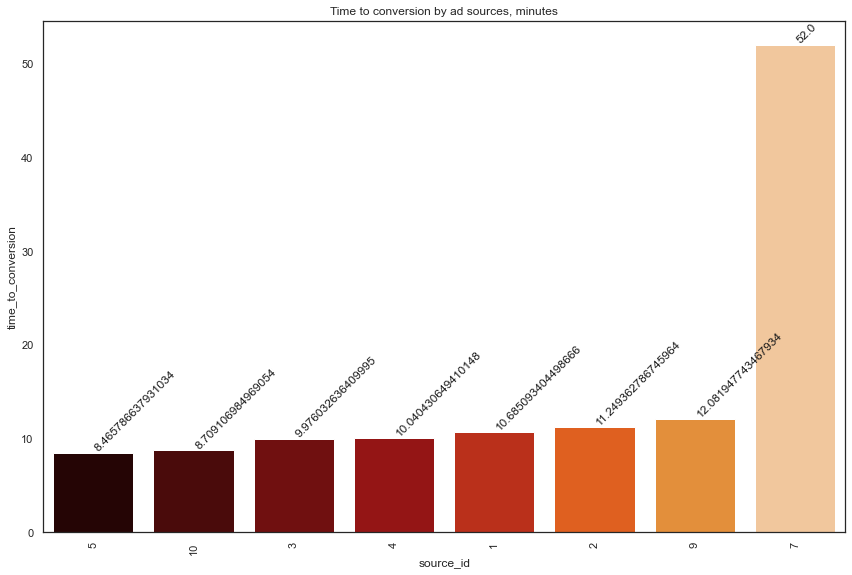

In [94]:
#plotting a barchart for conversion time by ad sources, minutes

plt.figure(figsize=(12,8))

# plot barh chart with index as x values
ax = sns.barplot(coversion_time_by_sources.index, coversion_time_by_sources.time_to_conversion, palette="gist_heat")
ax.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))
ax.set(xlabel="source_id", ylabel='time_to_conversion')

ax.set_xticklabels(coversion_time_by_sources.source_id)
for item in ax.get_xticklabels(): item.set_rotation(90)
for i, v in enumerate(coversion_time_by_sources["time_to_conversion"].iteritems()):        
    ax.text(i ,v[1], "{:,}".format(v[1]), color='k', va ='bottom', rotation=45)
plt.tight_layout()
plt.title('Time to conversion by ad sources, minutes')
plt.show()

Users that came from different sources usually make a purchase during 8-12 minutes. Only a user that came from source no. 7 took 52 minutes to convert (we have already seen that there was only 1 visitor from this ad source). Marketing department should pay attention to this ad source. `

Now we will check ad sources efficency for different types of devices

In [95]:
#Creating a table with orders split by devices and ad sources. 

device_sources = orders_visits.groupby(['source_id','device']).agg({'buy_ts':'count'}).reset_index()
device_sources = device_sources.rename(columns={'buy_ts': 'user_orders'})

In [96]:
device_sources_pivot = device_sources.pivot(index='source_id',columns='device',values='user_orders')

device_sources_pivot.head()

device,desktop,touch
source_id,,
1,3537,874
2,3922,998
3,7640,1433
4,7546,2076
5,5853,1092


In [97]:
#pie charts for source id shares
from plotly.subplots import make_subplots
import plotly.graph_objects as go

labels = ['1', '2', '3', '4', '5', '7', '9', '10']
value1 = device_sources_pivot['desktop']
value2 = device_sources_pivot['touch']
fig = make_subplots(2, 2, specs=[[{'type':'domain'},    {'type':'domain'}],
                           [{'type':'domain'}, {'type':'domain'}]], 
                    subplot_titles=['desktop', 'touch'])
fig.add_trace(go.Pie(labels=labels, values=value1, scalegroup='one',
                     name="desktop"), 1, 1)
fig.add_trace(go.Pie(labels=labels, values=value2, scalegroup='one',
                     name="touch"), 1, 2)

fig.update_layout(title_text='Shares of Ad Sources by Orders')
fig.show()

<br>For desktops ad sources no. 3 and 4 are equaly effective and bring together half of all converted visitors. Source no. 5 is 3rd most popular one and it brought 19% of orders. </br>
<br>For touch devices source no. 4 turned out to be the most effective, it brought every 3rd order to the site. Next popular and effective one is no. 4 with 20% of orders to the site. 16% and 15% of orders came from sources no. 5 and no. 2 respectively. Source no. 1 accounts for 13% of orders, and this number is almost the same for this source on decktops. </br>
<br>Generally the most effective ad sources are equally effective for both types of devices, as well as the least effective (no. 10, 9, 7) work poorly for both desktop and touch.</br>

## Sales. Number of orders during a given period of time. 

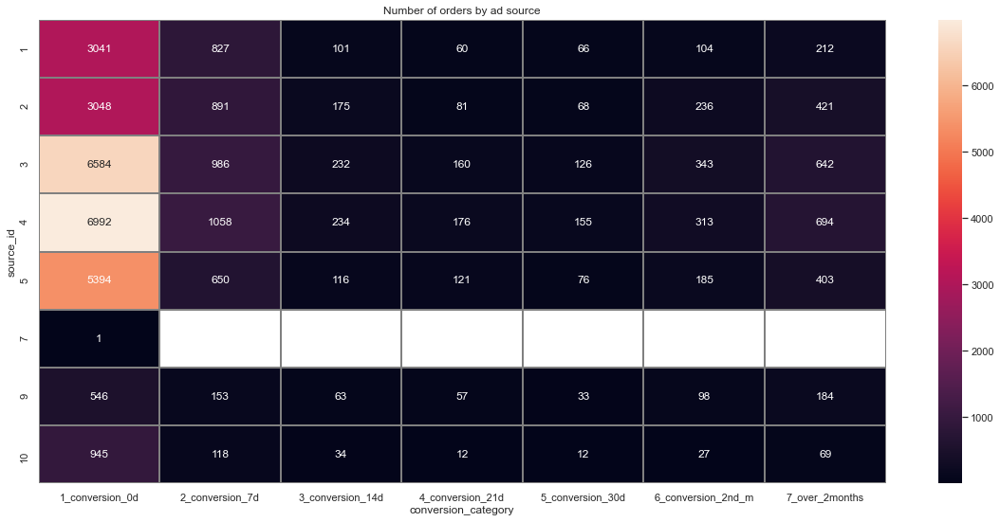

In [98]:
#calculating number of orders by ad source
pivot_orders_source = orders_visits.pivot_table(index='source_id',columns='conversion_category',values='buy_ts',aggfunc='count')
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Number of orders by ad source')
sns.heatmap(pivot_orders_source, annot=True, fmt='g', linewidths=1, linecolor='grey');

Sources no. 3 and 4 are the most effective with the largest number of orders made during 1st day of the site visit (6992 and 6584 orders). No. 5 source is also among leaders with 5394 orderd on the 1st day. 

## Sales. average purchase size. 

We will calculate an average revenue per order for each cohort and also for each ad source. Also we will calculate total revenue sum per ad source to check their efficency. 

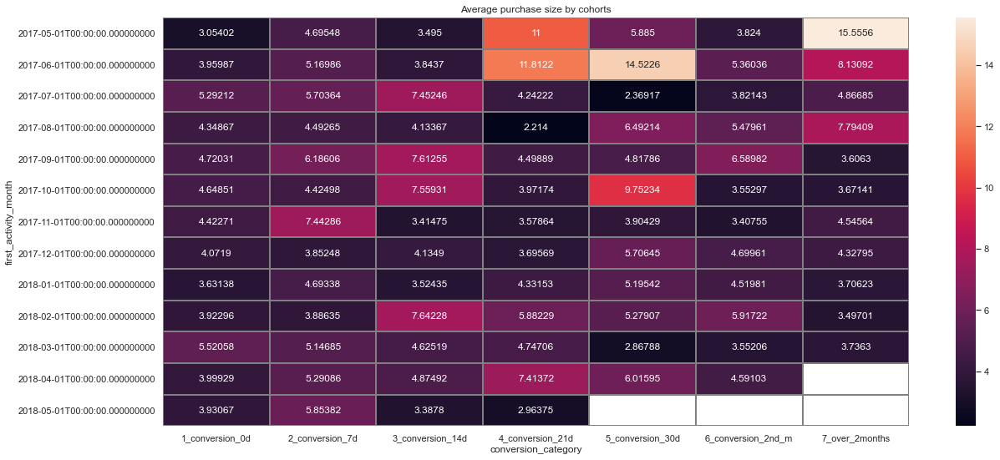

In [99]:
#calculating an average revenue per order per each cohort
pivot_revenue_cohort = orders_visits.pivot_table(index='first_activity_month',columns='conversion_category',values='revenue',aggfunc='mean')
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Average purchase size by cohorts')
sns.heatmap(pivot_revenue_cohort, annot=True, fmt='g', linewidths=1, linecolor='grey');

Figures show that visitor do not tend to place big orders immediately, numbers of purcheses on the 1st day of visit are quite moderate. The orders get bigger with the time and reach their maximum values on the 3rd and 4th weeks of the first month since the 1st visit. The biggest average revenue the site got from May cohort on the 3rd week and for orders made after 2nd month. June cohort is also one of the leadrs with orders made on the 3rd and 4th weeks.

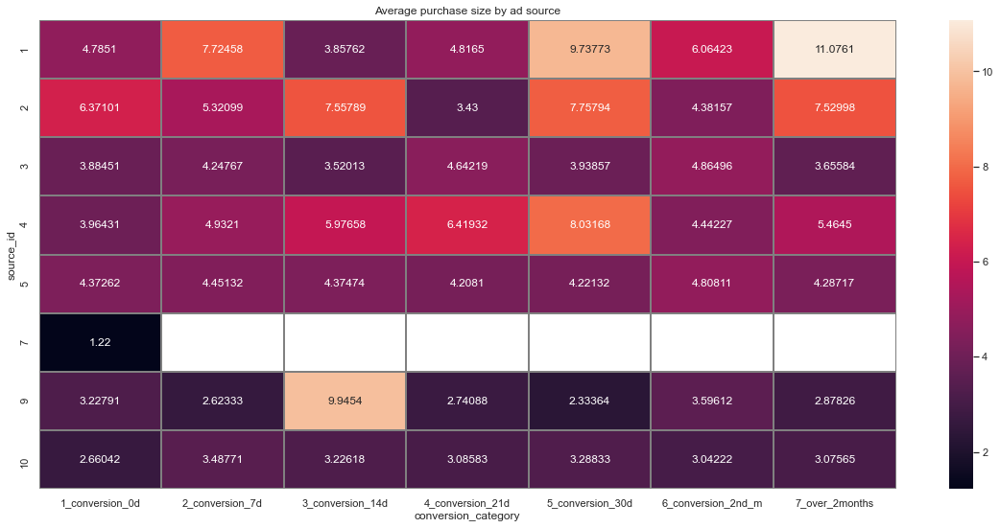

In [100]:
#calculating an average revenue per order per each ad source
pivot_revenue_source = orders_visits.pivot_table(index='source_id',columns='conversion_category',values='revenue',aggfunc='mean')
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Average purchase size by ad source')
sns.heatmap(pivot_revenue_source, annot=True, fmt='g', linewidths=1, linecolor='grey');

Here figures show that sourses no. 1, 2, 4 and 5 bring the higest everage revenue per order. The numbers reach their maximum also by the end of the 1st month. Here source no. 1 and 4 are the leaders. Source no. 9 brought good orders on the 2nd week. Still the biggest average revenue was broght by the source no. 1.

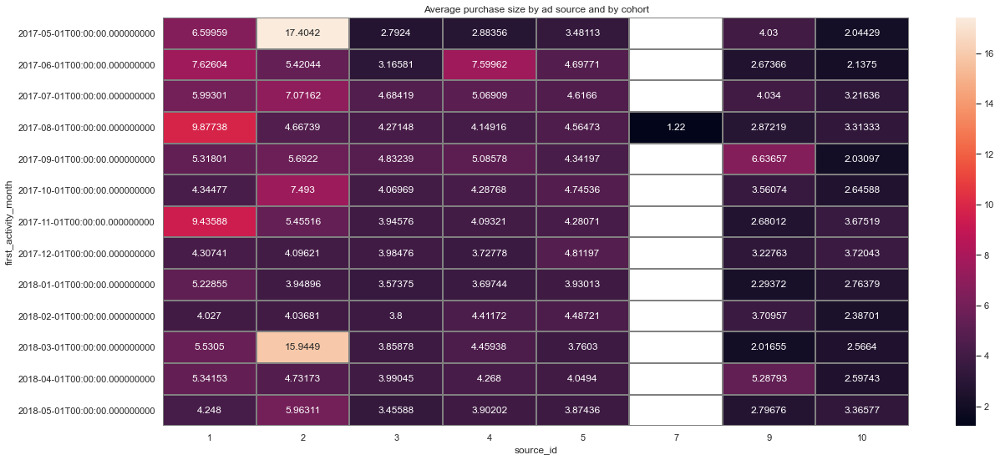

In [101]:
#combining the split by cohorts and by sources
pivot_revenue_source_cohort = orders_visits.pivot_table(index='first_activity_month',columns='source_id',values='revenue',aggfunc='mean')
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Average purchase size by ad source and by cohort')
sns.heatmap(pivot_revenue_source_cohort, annot=True, fmt='g', linewidths=1, linecolor='grey');

<br>Combining the two approaches we got the above table that shows source no. 2 has brought the biggest average revenue of May and March cohorts. This source was also effective for July and October cohorts. </br>
<br>Source no. 1 did hot have such bright numbers but worked well for several cohorts: August, November, June and May. Likewise for June cohort worked effectively ad sources no. 4 and 1.  </br>
<br> Ad source no. 9 grought good numbers of September and April cohorts. </br>

## Sales. How much money do the customers bring (LTV). 

We are going to calcutale total revenue split by ad sources and then based on these figures estimate revenue per customer (LTV).  

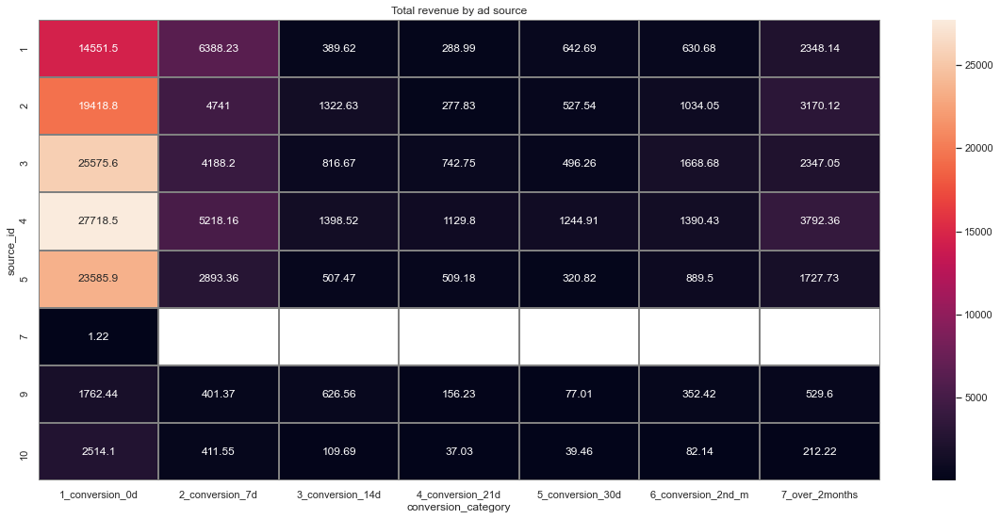

In [102]:
#calculating an total revenue per each ad source
pivot_revenue_source = orders_visits.pivot_table(index='source_id',columns='conversion_category',values='revenue',aggfunc='sum')
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Total revenue by ad source')
sns.heatmap(pivot_revenue_source, annot=True, fmt='g', linewidths=1, linecolor='grey');

The most effective in terms of total revenue was source no. 4, 3 and 5. They brougt the most total revenue during the 1st day. While during the 1st week of conversion the most effective were sources no. 4 and 1. The source no. 4 keept being the most effective even after the 2nd month.  

We will also add a table with revenue per month per source to use it in furthe calculations.

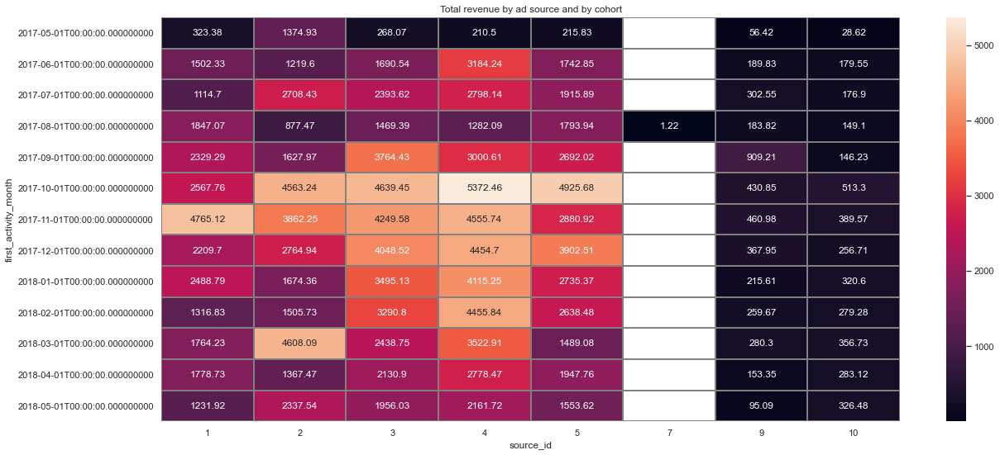

In [103]:
#combining the split by cohorts and by sources
pivot_revenue_source_cohort = orders_visits.pivot_table(index='first_activity_month',columns='source_id',values='revenue',aggfunc='sum')
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Total revenue by ad source and by cohort')
sns.heatmap(pivot_revenue_source_cohort, annot=True, fmt='g', linewidths=1, linecolor='grey');

Here the most profitable turned out to be sources no. 4 (cohorts of October, November, December and February) and no. 3 (cohorts of October, Novenber and December). 


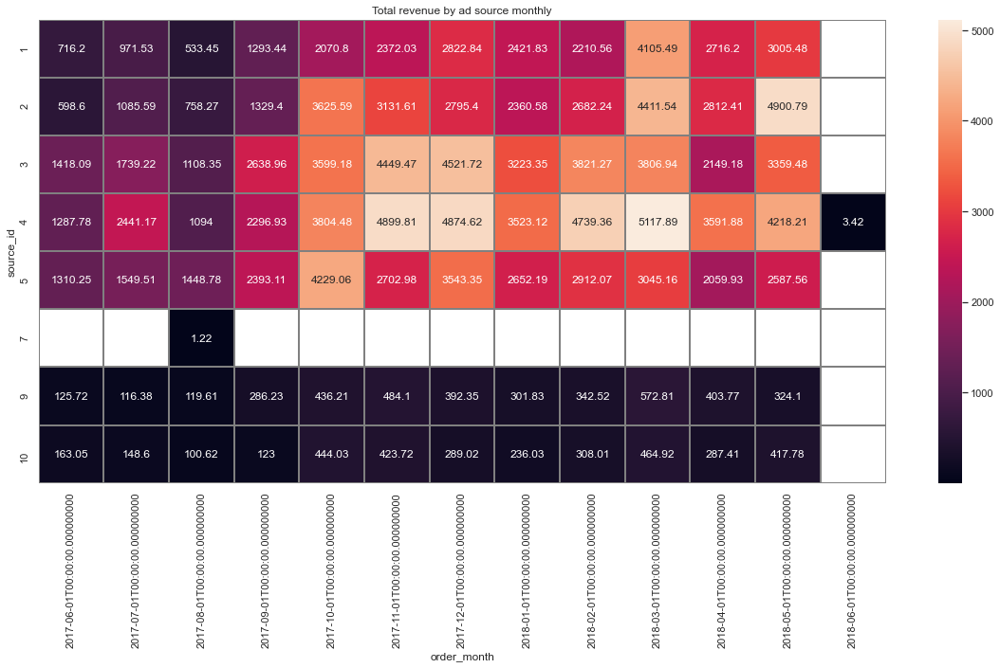

In [104]:
orders_visits['order_month'] = orders_visits['buy_ts'].astype('datetime64[M]') #column with order month
pivot_revenue_source_monthly = orders_visits.pivot_table(index='source_id',columns='order_month',values='revenue',aggfunc='sum')
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Total revenue by ad source monthly')
sns.heatmap(pivot_revenue_source_monthly, annot=True, fmt='g', linewidths=1, linecolor='grey');


The most lucrative were sources no. 4 and 3, the least effective ones were no. 9 and 10. AS to the months March and October brought the most amount of revenue. 

In [105]:
#Creating a table with revenue split by devices and ad sources. 

device_revenue = orders_visits.groupby(['source_id','device']).agg({'revenue':'sum'}).reset_index()
device_revenue['revenue'] = device_revenue['revenue'].fillna(0)
device_revenue_pivot = device_revenue.pivot(index='source_id',columns='device',values='revenue')

device_revenue_pivot.head()

device,desktop,touch
source_id,,
1,20634.48,4605.37
2,24892.19,5599.83
3,30632.51,5202.70
4,32860.12,9032.55
5,26269.57,4164.38


In [106]:
#pie charts for source id shares


labels = ['1', '2', '3', '4', '5', '7', '9', '10']
value1 = device_revenue_pivot['desktop']
value2 = device_revenue_pivot['touch']
fig = make_subplots(2, 2, specs=[[{'type':'domain'},    {'type':'domain'}],
                           [{'type':'domain'}, {'type':'domain'}]], 
                    subplot_titles=['desktop', 'touch'])
fig.add_trace(go.Pie(labels=labels, values=value1, scalegroup='one',
                     name="desktop"), 1, 1)
fig.add_trace(go.Pie(labels=labels, values=value2, scalegroup='one',
                     name="touch"), 1, 2)

fig.update_layout(title_text='Shares of Ad Sources by Revenue')
fig.show()

<br>For desktops the most lucrative are ad sources no. 4 and 3, together they accout for 45% of revenue. Source no. 5 and 2 are slightly less effective but still brought 37% of revenue. </br>
<br>For touch devices source no. 4 is the most effective, it brought 1/3 of the every 3th order to the site. The sources no. 2 and 3 brought together 36% of revenue.</br>
<br>The least effective sources for both types are no. 7, 9 and 10. </br>

In [107]:
#Calculating LTV deviding revenue by number of new customers per every group of conversion:
LTV = pivot_revenue_source / pivot_conversion_source #pivot_conversion_source = number of unique visitors

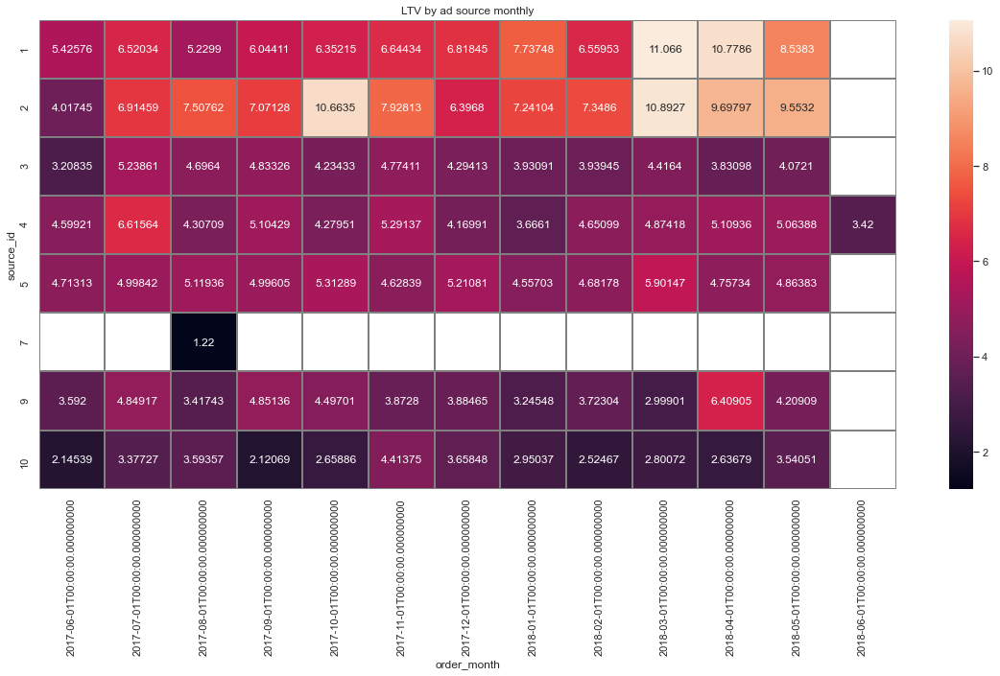

In [108]:
#Calculating LTV deviding revenue by number of new customers per month
pivot_conversion_source_monthly = orders_visits.pivot_table(index='source_id',columns='order_month',values='uid',aggfunc='nunique')
LTV_monthly = pivot_revenue_source_monthly / pivot_conversion_source_monthly 
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('LTV by ad source monthly')
sns.heatmap(LTV_monthly, annot=True, fmt='g', linewidths=1, linecolor='grey');

The calculations show that ad source no. 1 and 2 brings customers with the most revenue. Their customers bring the most revenue per capita during all spring months. Also for the source no. 2 Autumn months arevery effective, especially October. Sources no. 1, 2 and 4 are also more lucative than the rest but still fare worse than no.9. The least revenue per capita brings source no. 10.  

### Conclusion
<br>Having merged the visits table with the oders table we have found that it takes from 0 to 295 days a visitor to convert since the date of his first visit. If we split the visitors by cohorts we can see that the most of them convert duriing the same day as they visit the site. The biggest number of 'd0' converted visitors came in October, December and January. These cohorts look like the best targrted ones. </br>
<br>Ad sources no. 4 , 3 and 5 brought the biggest number of visitors that converted on the day of their first visit and during the 1st week since their 1st visit. The same we can say about the number of orders.  </br>
<br>An average time to convert during 1 session is from 8.5 to 12 minutes. </br>
<br>As to the different type of devices,  ad sources no. 3 and 4 bring the most number of converted visitors both to desktop and to touch ones. The least effective are also the same: no. 9 and 10. </br>

<br>Analysing average size of a purchase we can say that May, June and October cohorts had the biggerst numbers here. </br>
<br>If we split it by the ad sources we can see that sourses no. 1, 2, 4 and 5 bring the higest everage revenue per order.</br>
<br>Combining the two approaches we got source no. 2 as the most effective for May, July, October and March cohorts. The next leading ad source is no. 1 that worked well for August, November, June and May cohorts.</br>

<br>As to the total revenue the most profitable turned out to be sources no. 4 (cohorts of October, November, December and February) and no. 3 (cohorts of October, Novenber and December). </br>
<br>As to device type, both for desktops and for touch devices the most lucrative is sources no. 4. On the 2nd place for desctops is source no. 3 and for touch ones is source no. 2. </br>
<br>LTV figures show that ad sources no. 2 is the most effective one. </br>


## Marketing. How much money was spent? Overall/per source/over time

We are going to analyse overall costs, costs per source and their dynamic. 

In [109]:
#calculating total costs

total_costs = costs['costs'].sum()
print('Value of overall costs for the whole period is ', total_costs, '.')

Value of overall costs for the whole period is  329131.62 .


In [110]:
#Calculating costs per ad source
costs_per_source = costs.groupby('source_id')['costs'].sum().sort_values().reset_index()

costs_per_source


,source_id,costs
0,9,5517.49
1,10,5822.49
2,1,20833.27
3,2,42806.04
4,5,51757.10
5,4,61073.60
6,3,141321.63


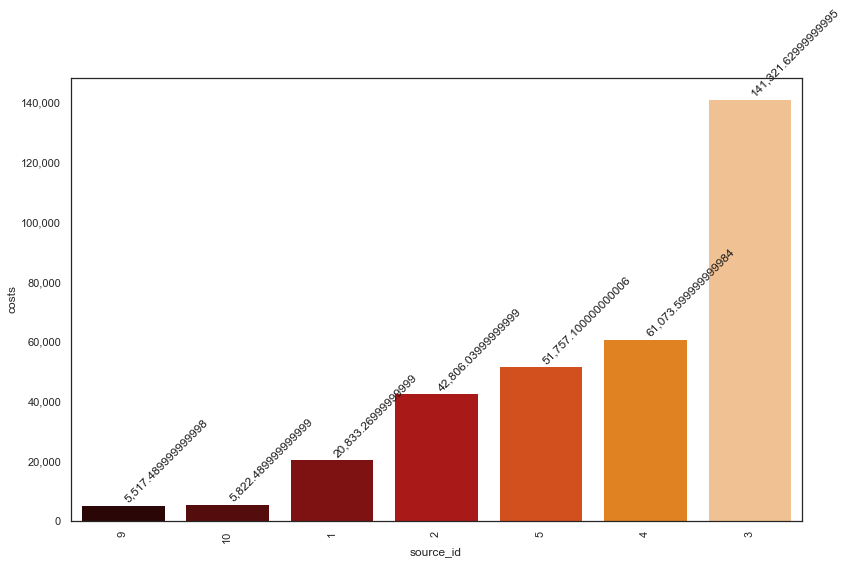

In [111]:
#plotting a barchart for costs by ad sources

plt.figure(figsize=(12,8))

# plot barh chart with index as x values
ax = sns.barplot(costs_per_source.index, costs_per_source.costs, palette="gist_heat")
ax.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))
ax.set(xlabel="source_id", ylabel='costs')

ax.set_xticklabels(costs_per_source.source_id)
for item in ax.get_xticklabels(): item.set_rotation(90)
for i, v in enumerate(costs_per_source["costs"].iteritems()):        
    ax.text(i ,v[1], "{:,}".format(v[1]), color='k', va ='bottom', rotation=45)
plt.tight_layout()
plt.show()

The most expencive ad source is source no. 3 and the least expencive ones are no. 9 and 10. 

In [112]:
#getting the costs structure

fig = px.pie(costs_per_source, values='costs', names='source_id', title="Structure of costs", color_discrete_sequence=px.colors.sequential.RdBu)
fig.show()


The value of total costs for the whole period is 329131.62. 43% of them company spends on source no. 3. Sources no. 4 and 5 receive 18 and 15 % of all costs respectively. 

In [113]:
#Calculating dynamic of costs 
costs_per_date = costs.groupby('dt')['costs'].sum().reset_index()
costs_per_date

,dt,costs
0,2017-06-01,735.26
1,2017-06-02,721.19
2,2017-06-03,450.85
3,2017-06-04,761.16
4,2017-06-05,821.44
...,...,...
359,2018-05-27,532.87
360,2018-05-28,619.44
361,2018-05-29,784.79
362,2018-05-30,1183.00


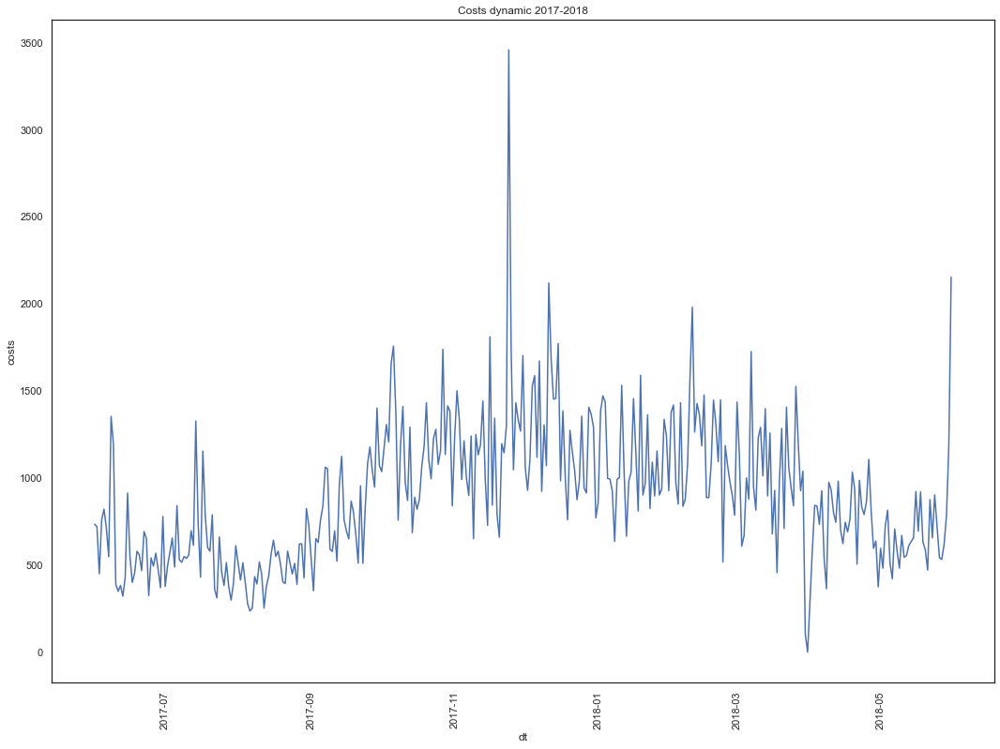

In [114]:
sns.lineplot(x="dt", y="costs", data=costs_per_date, markers=True, dashes=True)
plt.xticks(rotation=90)
plt.title('Costs dynamic 2017-2018')
plt.show()

Generally costs dynamic corresponds with the dynamic of users activity with peak periods from October to December and low season in summer.

In [115]:
#to see the bigger picture we will group the costs per week
costs['costs_year']  = costs['dt'].dt.year
costs['costs_month'] = costs['dt'].dt.month
costs['costs_week'] = costs['dt'].dt.week

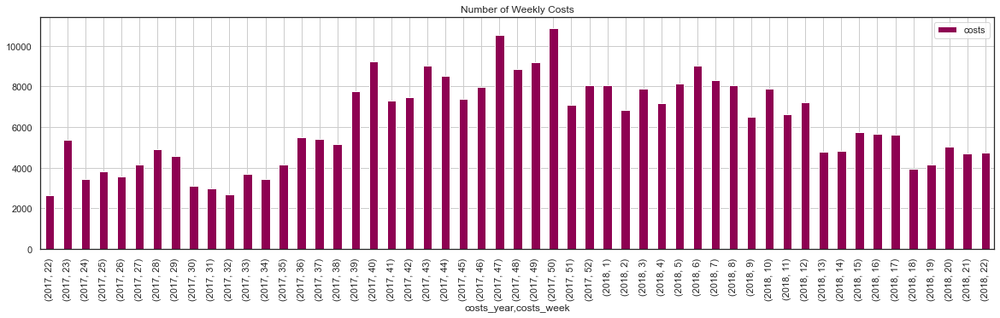

In [116]:
#plotting weekly costs chart
(costs.groupby(['costs_year', 'costs_week'])
 .agg({'costs': 'sum'})
 .plot(y='costs', kind='bar', grid=True, figsize=(20,5), cmap='PiYG', title='Number of Weekly Costs')
)
plt.show()

It will be interesting to compare with dynamic of weekly visits:

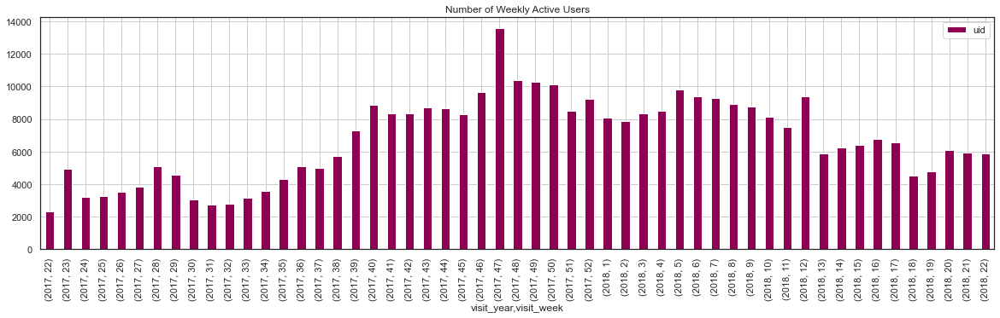

In [117]:
# WAU chart
(visits.groupby(['visit_year', 'visit_week'])
 .agg({'uid': 'count'})
 .plot(y='uid', kind='bar', grid=True, figsize=(20,5), cmap='PiYG', title='Number of Weekly Active Users')
)
plt.show()

We can see correlarion between ad spendings and user activity. The bigger costs the more visits gets the site: rise of costs on week 23/2017 corresponds with rise of visits on the same week, the same dinamic we can see on weeks 28/2017, 40/2017, 47/2017, 12/2018 and 20/2018. Rise of spendings on weeks 43/2017, 50/2017 and 10/2018 did not result in rise of visits. Ad compaigns of these weeks should be analysed more thoroughly.

Dinamics of costs generally corresponds with the dynamics of user activity. It might mean that almost all marketing activities generate users flow.

## Marketing. How much did customer acquisition from each of the sources cost.

We are going to calculate the cost of acquisition (CAC per user per source) by calculating the cost of marketing per source and then dividing it by number of users that came from that source. 

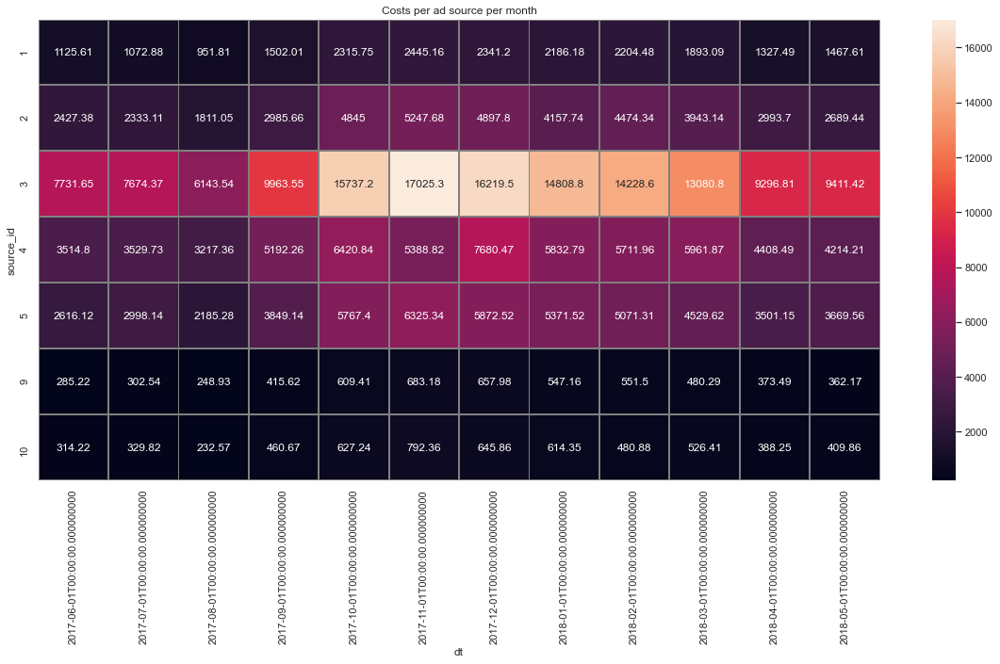

In [118]:
#Costs per ad source per month
#adding column with month of costs 
costs['dt'] = costs['dt'].astype('datetime64[M]')
#grouping data in pivot table
pivot_costs_source_monthly = costs.pivot_table(index='source_id',columns='dt',values='costs',aggfunc='sum')

#plotting heatmap for the pivot table
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Costs per ad source per month')
sns.heatmap(pivot_costs_source_monthly, annot=True, fmt='g', linewidths=1, linecolor='grey');

Now we will get all the converted users per month per ad source in one table

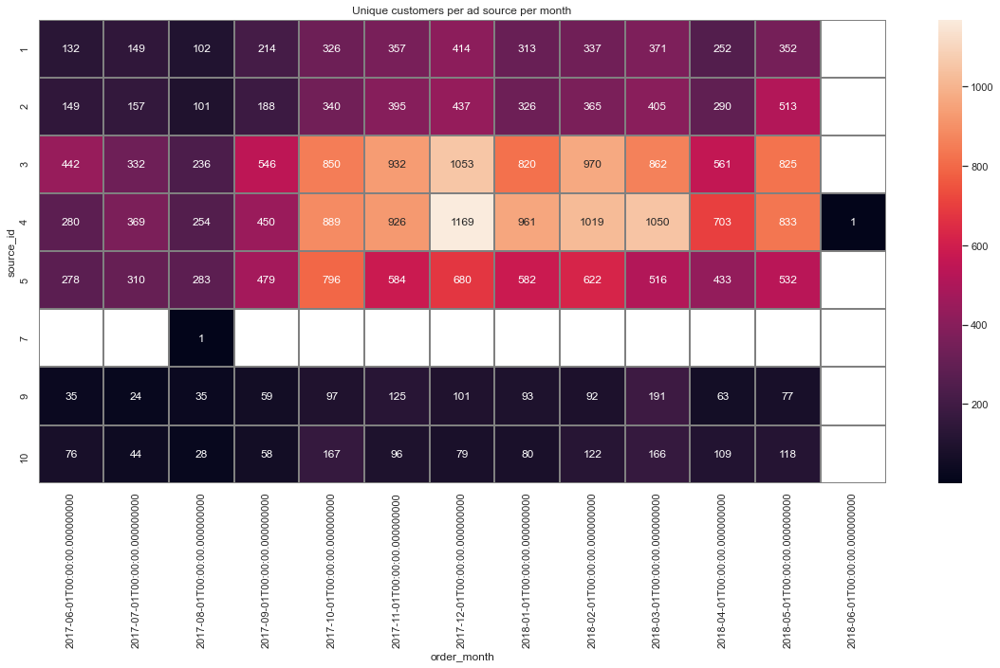

In [119]:
#calculating number of converted users per month per ad source
pivot_users_source_monthly = orders_visits.pivot_table(index='source_id',columns='order_month',values='uid',aggfunc='nunique')

#plotting heatmap for the pivot table
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Unique customers per ad source per month')
sns.heatmap(pivot_users_source_monthly, annot=True, fmt='g', linewidths=1, linecolor='grey');

The new customers are mainly attracted by sources no. 3, 4 and 5. And the months with the biggest number of new converted users are December, February and March. 

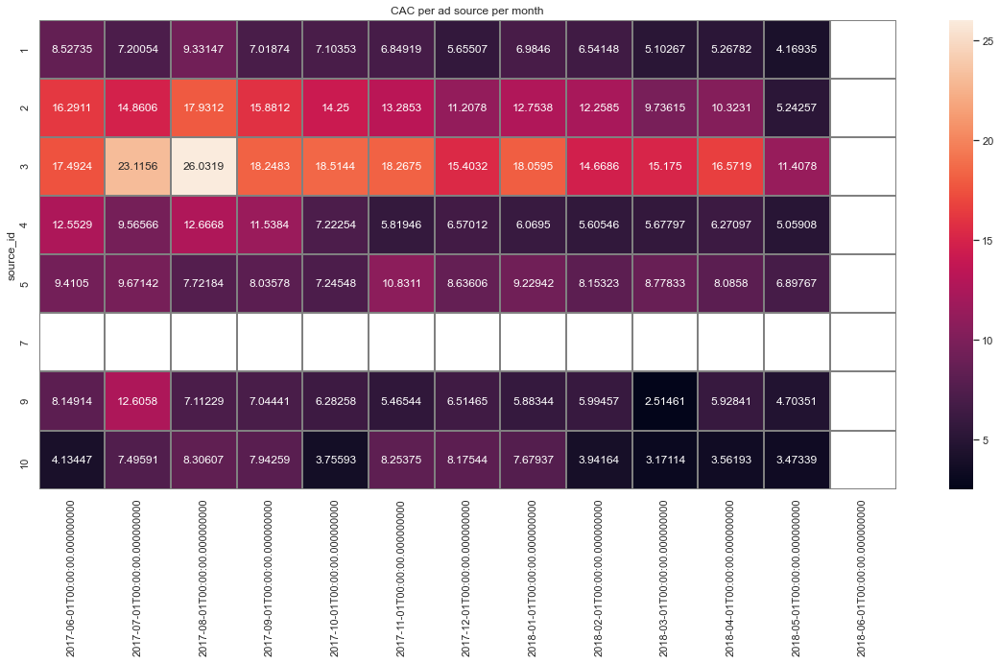

In [120]:
#calculating CAC
CAC = pivot_costs_source_monthly / pivot_users_source_monthly
#plotting heatmap for the CAC 
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('CAC per ad source per month')
sns.heatmap(CAC, annot=True, fmt='g', linewidths=1, linecolor='grey');

<br>As the calculations show despite the fact that the company spent the most of the marketing budget on source no. 3, sources no. 1, 5, 4, 9 and 10 bring the biggest number of converted users with the least expences. </br>
<br>Thus the most expencive users come from sources no. 2 and 3. The most expensive customers were brought by source no. 3 in August (26.03 per capita) and in July (23.11 per capita). </br>
<br>For source no. 4 the least effective compaign was in JUne and in August with the most expencive converted users. (12.6 per user).</br>
<br>Source no. 5 the least effective compaign was in November with the most expencive converted users. (12.6 per user).</br>
<br>Source no. 9 has average price of conversion but its campaign in July was the least effective with a very high price of conversion.</br>
<br>Sorces no. 1 and 10 are the sources of mainly cheap conversions. </br>
<br></br>

Now we will determine which ad sources are profitable and which are not (if LTV < CAC)

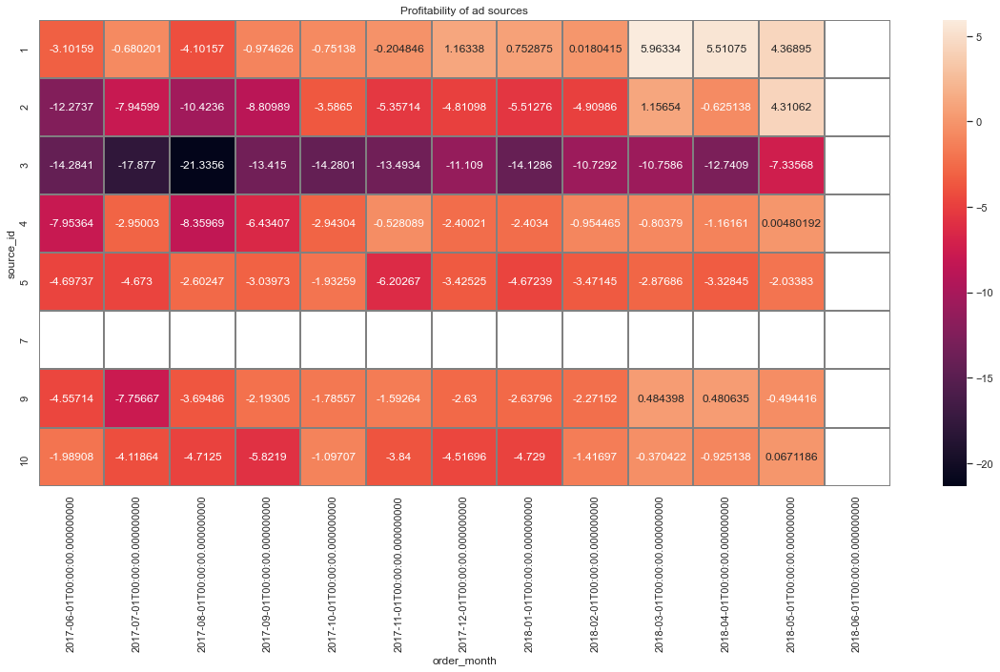

In [121]:
Sources_profitability = LTV_monthly -CAC

#plotting heatmap for the sources profitability 
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('Profitability of ad sources')
sns.heatmap(Sources_profitability, annot=True, fmt='g', linewidths=1, linecolor='grey');


The heatmap clearly illustrates that source no. 3 performs the least effective way making the haviest loses (especially in July and August). The best performance has source no. 1 with the biggest number of months with LTV > CAC. In May there was the biggest number of ad sources with LTV > CAC. 

## Marketing. How worthwhile where the investments? (ROMI)

We will determine ROMI (return on marketing investment) by dividing LTV by CAC

In [122]:
#creating a general table for calculations
report = orders_visits[['uid', 'buy_ts', 'first_order_date', 'revenue']]
report['buy_ts'] = report['buy_ts'].astype('datetime64[M]')
report['first_order_date'] = report['first_order_date'].astype('datetime64[M]')
report = report.rename(columns={'buy_ts': 'order_month', 'first_order_date':'first_order_month'})
report

,uid,order_month,first_order_month,revenue
0,10329302124590727494,2017-06-01,2017-06-01,17.00
1,11627257723692907447,2017-06-01,2017-06-01,0.55
2,17903680561304213844,2017-06-01,2017-06-01,0.37
3,16109239769442553005,2017-06-01,2017-06-01,0.55
4,14200605875248379450,2017-06-01,2017-06-01,0.37
...,...,...,...,...
50410,12296626599487328624,2018-05-01,2018-05-01,4.64
50411,11369640365507475976,2018-05-01,2018-05-01,5.80
50412,1786462140797698849,2018-05-01,2018-05-01,0.30
50413,3993697860786194247,2018-05-01,2018-05-01,3.67


In [123]:
cohort_sizes = report.groupby('first_order_month').agg({'uid': 'nunique'}).reset_index()
cohort_sizes.columns = ['first_order_month', 'n_buyers']
cohort_sizes.head()

,first_order_month,n_buyers
0,2017-06-01,1392
1,2017-07-01,1368
2,2017-08-01,1009
3,2017-09-01,1939
4,2017-10-01,3340


In [124]:
cohorts = report.groupby(['first_order_month','order_month']).agg({'revenue': 'sum'}).reset_index()
cohorts.head()

,first_order_month,order_month,revenue
0,2017-06-01,2017-06-01,5619.69
1,2017-06-01,2017-07-01,85.60
2,2017-06-01,2017-08-01,62.59
3,2017-06-01,2017-09-01,63.66
4,2017-06-01,2017-10-01,128.26


In [125]:
cohorts_general = pd.merge(cohort_sizes, cohorts, on='first_order_month')
cohorts_general.head()

,first_order_month,n_buyers,order_month,revenue
0,2017-06-01,1392,2017-06-01,5619.69
1,2017-06-01,1392,2017-07-01,85.60
2,2017-06-01,1392,2017-08-01,62.59
3,2017-06-01,1392,2017-09-01,63.66
4,2017-06-01,1392,2017-10-01,128.26


In [126]:
cohorts_general['cohort_age'] = (cohorts_general['order_month'] - cohorts_general['first_order_month']) / np.timedelta64(1, 'M')
cohorts_general['cohort_age'] = cohorts_general['cohort_age'].round().astype('int')

cohorts_general.head()

,first_order_month,n_buyers,order_month,revenue,cohort_age
0,2017-06-01,1392,2017-06-01,5619.69,0
1,2017-06-01,1392,2017-07-01,85.60,1
2,2017-06-01,1392,2017-08-01,62.59,2
3,2017-06-01,1392,2017-09-01,63.66,3
4,2017-06-01,1392,2017-10-01,128.26,4


In [127]:
ppp = cohorts_general.pivot_table(
    index='first_order_month', 
    columns='cohort_age', 
    values='n_buyers').round().fillna('')
ppp

cohort_age,0,1,2,3,4,5,6,7,8,9,10,11
first_order_month,,,,,,,,,,,,
2017-06-01,1392.0,1392,1392,1392,1392,1392,1392,1392,1392,1392,1392,1392
2017-07-01,1368.0,1368,1368,1368,1368,1368,1368,1368,1368,1368,1368,
2017-08-01,1009.0,1009,1009,1009,1009,1009,1009,1009,1009,1009,,
2017-09-01,1939.0,1939,1939,1939,1939,1939,1939,1939,1939,,,
2017-10-01,3340.0,3340,3340,3340,3340,3340,3340,3340,,,,
2017-11-01,3220.0,3220,3220,3220,3220,3220,3220,,,,,
2017-12-01,3698.0,3698,3698,3698,3698,3698,,,,,,
2018-01-01,2919.0,2919,2919,2919,2919,,,,,,,
2018-02-01,3218.0,3218,3218,3218,,,,,,,,


In [128]:
cohorts_general['ltv'] = cohorts_general['revenue'] / cohorts_general['n_buyers']

report_pivot = cohorts_general.pivot_table(
    index='first_order_month', 
    columns='cohort_age', 
    values='ltv', 
    aggfunc='mean').round()

report_pivot.fillna('')

cohort_age,0,1,2,3,4,5,6,7,8,9,10,11
first_order_month,,,,,,,,,,,,
2017-06-01,4.0,0,0,0,0,0,0,0,0,0,0,0
2017-07-01,6.0,0,0,0,0,0,0,0,0,0,0,
2017-08-01,5.0,0,0,0,0,0,0,0,0,0,,
2017-09-01,5.0,1,0,0,0,0,0,0,0,,,
2017-10-01,5.0,0,0,0,0,0,0,0,,,,
2017-11-01,5.0,1,0,0,0,0,0,,,,,
2017-12-01,4.0,0,0,0,0,0,,,,,,
2018-01-01,4.0,0,0,0,0,,,,,,,
2018-02-01,4.0,0,0,0,,,,,,,,


In [129]:
costs_ = costs[['dt', 'costs']]

In [130]:
costs_['dt'] = costs_['dt'].astype('datetime64[M]')
costs_

,dt,costs
0,2017-06-01,75.20
1,2017-06-01,62.25
2,2017-06-01,36.53
3,2017-06-01,55.00
4,2017-06-01,57.08
...,...,...
2537,2018-05-01,9.92
2538,2018-05-01,21.26
2539,2018-05-01,11.32
2540,2018-05-01,33.15


In [131]:
costs_m = costs_.groupby(['dt']).agg({'costs': 'sum'}).reset_index()
costs_m

,dt,costs
0,2017-06-01,18015.00
1,2017-07-01,18240.59
2,2017-08-01,14790.54
3,2017-09-01,24368.91
4,2017-10-01,36322.88
5,2017-11-01,37907.88
6,2017-12-01,38315.35
7,2018-01-01,33518.52
8,2018-02-01,32723.03
9,2018-03-01,30415.27


In [132]:
report_general = pd.merge(cohorts_general, costs_m, left_on='order_month', right_on='dt')
report_general['cac'] = report_general['costs'] / report_general['n_buyers']
report_general.head()

,first_order_month,n_buyers,order_month,revenue,cohort_age,ltv,dt,costs,cac
0,2017-06-01,1392,2017-06-01,5619.69,0,4.037134,2017-06-01,18015.00,12.941810
1,2017-06-01,1392,2017-07-01,85.60,1,0.061494,2017-07-01,18240.59,13.103872
2,2017-07-01,1368,2017-07-01,7966.40,0,5.823392,2017-07-01,18240.59,13.333765
3,2017-06-01,1392,2017-08-01,62.59,2,0.044964,2017-08-01,14790.54,10.625388
4,2017-07-01,1368,2017-08-01,305.54,1,0.223348,2017-08-01,14790.54,10.811798


In [133]:
report_general['romi'] = report_general['ltv'] / report_general['cac']
romi_pivot = report_general.pivot_table(
    index='first_order_month', 
    columns='cohort_age', 
    values='romi', 
    aggfunc='mean')

romi_pivot.cumsum(axis=1).round(2).fillna('')

cohort_age,0,1,2,3,4,5,6,7,8,9,10,11
first_order_month,,,,,,,,,,,,
2017-06-01,0.31,0.32,0.32,0.32,0.33,0.33,0.33,0.33,0.34,0.34,0.34,0.35
2017-07-01,0.44,0.46,0.48,0.48,0.48,0.49,0.49,0.49,0.5,0.5,0.5,
2017-08-01,0.32,0.33,0.34,0.34,0.35,0.35,0.35,0.35,0.35,0.36,,
2017-09-01,0.39,0.43,0.44,0.45,0.47,0.48,0.5,0.52,0.54,,,
2017-10-01,0.45,0.48,0.49,0.51,0.53,0.54,0.54,0.55,,,,
2017-11-01,0.44,0.49,0.51,0.54,0.59,0.62,0.64,,,,,
2017-12-01,0.42,0.45,0.48,0.5,0.51,0.53,,,,,,
2018-01-01,0.36,0.37,0.39,0.41,0.42,,,,,,,
2018-02-01,0.41,0.43,0.45,0.47,,,,,,,,


Neither of cohorts have paid off during their lifetime (ROMI<1). March/2018 cohort on the 3rd month  has gotten the most close to pay-off of all the othe cohorts (ROMI 0.72). The most far from pay-off stage is January cohort with ROMI < 50% by the end of its lifetime. 

To define ROMI per ad source we will divide LTV by source/CAC by source:

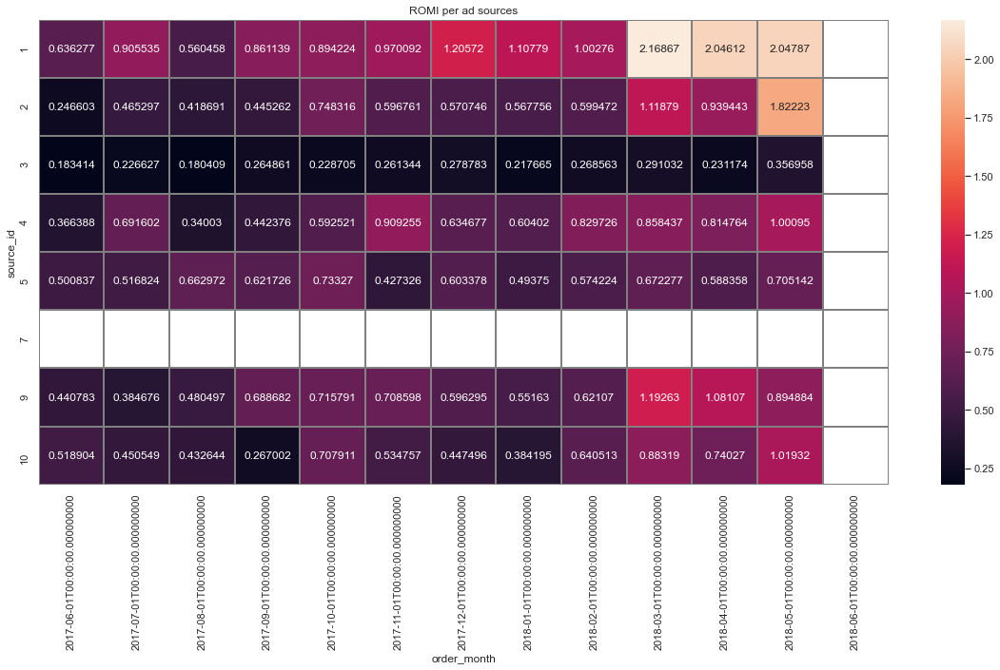

In [134]:
ROMI = LTV_monthly/CAC
#plotting heatmap for ROMI 
sns.set(style='white')
plt.figure(figsize=(20, 9))
plt.title('ROMI per ad sources')
sns.heatmap(ROMI, annot=True, fmt='g', linewidths=1, linecolor='grey');

ROMI calculations prove that source no. 3 does not pay-off during the whole period. The best source from the point of view of investments is source no. 1, it has the biggest number of months with LTV>CAC. Second best are sources no. 2 and 9.

### Conclusion
<br>Total costs for the whole period is 329131.62. Analysing costs of the company we can see that 43% of its marketing costs are spent on ad source no. 3; source no. 4 is on the 2nd plase and the least investments got source no. 9. 
We can see also that there is a correlarion between ad spendings and user activity. The bigger costs the more visits gets the site.</br>
Also dinamic of costs has the same seasonal fluctuaions with peak season starting in September and ending in March. </br>
<br>Splitting costs by ad sources by months we can see that during the Autumn-Winter (high season) marketing spendings rise for all channels but the leading one is source no. 3 followed up by sources no. 4, 5 and 2. </br>
<br>But if we take into account the number of converted customers and calculate CAC, we can clearly see that source no. 3 is the least effective as it has the highest costs of converted users. The most effective channels in this respect are sources no. 1, 5, 4, 9 and 10.  </br>
<br>ROMI value shows that neither of the cohorts got to the pay-off stage, though March cohort got closer to it (with ROMI = 0.72). 
If we split it by the ad channels it is getting clear that the source no. 1 is the best one from the point of view of investments as it has the biggest number of months with LTV>CAC (from December 2017 to May 2018). </br>
<br>Than go sources no. 2 and 9 with 2 positive months each. </br>

<br>The company should  prioritise the sources no. 1, 2 and 9 when forming the next marketing budgets.  </br>


# General Conclusion




<br>In cource of work we have studied Afisha's product itself, its's marketing channels and sales efficiency. </br>
<br>Afisha's product has strong seasonal fluctuations with low season in summer and high season in fall-winter. Generally activity on site grew through 2017-2018 (DAU, WAU and MAU values grew). 
<br>The number of visits via touch devices is significantly lower than via desktop ones: 266 vs 721 per day on average. Touch users demonstrate less fluctuations during the period.</br>
<br>Median value of session length for touch devices visits is shorter than desktop ones (180 sec vs 360 sec). 
We can see that Afisha's customers prefer to use desktop devices and stay on the site longer than with the app. 

An average retantion rate is not high but grew from 5% in 2017 to 19% in 2018. In 2017 the highest retention rates were among users that came in August and in October (every 5th user came back next month). It might mean that ad campaigns of these periods were the most effectively targeted. Planning the next ad campaigns the marketing department could use positive expetience of August and October campaigns. </br>
<br> Most of the converted users tent to make orders during their first visit. Although amount of orders got bigger among those who came back later. It should be taken into account when building the funnel.  </br>

<br>As to the revenue and costs is concerned, in 2017-2018 marketing costs were bigger than the revenue (329,131.62 vs 252,057.2). </br>

<br>Desktop devices brought more revenue than touch ones. 
The biggest ad sources for both types of devices were no. 3 and 4, together they brought 50% of orders. Sources no. 9 and 10 account only for 6% of orders. </br>

<br>But if we take into account not only the number of visitors and orders but also costs of their aquisition we will see that source no. 3 is the least effective one. CAC and ROMI show that this channel has the higest cost of user aquisition that is not covered by the revenue received. Moreover the source has no positive tendency, during all the months CAC is 18-35% bigger than LTV. </br>

<br>The most effective sources judging by ROMI value are no. 1, 2 and 9. They account for the least number of orders (for both types of devices) but the share of revenue brought by sources 1 and 2 is much bigger.  (See piecharts 'Shares of Ad Sources by Revenue' and 'Shares of Ad Sources by Orders'). For touch devices source no. 2 performs even better than for desktops.</br>

<br></br>
<br>Based on the calculations above we can suggest to restructure marketing investments the following way.</br>
<br>Sources no. 2, 1, 9 should get the bigger investments and share of marketing budget. Source no. 3 either should not be used at all or the campaign should be retargrted. This channel brings the biggest number of visitors but their orders do not cover their aquisition costs. It might mean that the channel brings poorly targeted audience. </br>
<br>As Afisha users prefer desktop devices, marketing compaigns should be planned accordingly with more attention to site content and its UX.</br>
<br>As soon as Afisha visitors use app less than the site, we would offer firstly to try making it more convenient with better UX and secondly to test some additional channels for touch devices to get more app downloads. </br>
<br>We have seen seasonal fluctuations in user activity and advice Afisha to make them less sharp by:  
<br> - getting some seasonal offers and coupons to the site,</br>
<br> - pre-sale of the tickets prior to the start of high season,</br>
<br> - keeping users activity on the site by sending emails. </br>
<br>Afisha might also try some diversification of sources and test other ad sources and channels. </br>